In [1]:
import os
import ast
import glob
import h5py
import pickle

import numpy as np
import pandas as pd
import networkx as nx
from scipy.stats import spearmanr

from sklearn.metrics import mean_absolute_error as mae
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import r2_score
from sklearn.metrics import silhouette_score
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans

from rdkit import Chem
from rdkit.Chem import Descriptors
from rdkit.Chem import MACCSkeys
from rdkit.Chem.Draw import rdMolDraw2D
from rdkit.Chem.Draw import DrawingOptions

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import proplot as pplt

import tensorflow as tf
from tensorflow import keras

import uncertainty_toolbox as ut

from gnn_uq.gnn_model import RegressionUQSpace
from gnn_uq.load_data import load_data
from gnn_uq.result import NLL, cNLL, miscal_area, load_post_training



pd.set_option('display.max_columns', None)

# Constants
NAME = ['Lipo', 'ESOL', 'FreeSolv', 'QM7']

COLOR = []
cycle = pplt.Cycle('ggplot')
cycle2 = pplt.Cycle('Dark2')
for c in cycle:
    COLOR.append(c['color'])
for c in cycle2:
    COLOR.append(c['color'])

pplt.rc.cycle = 'ggplot'

## 1. Search Reward
### 1.1 Search reward for each individual random seed

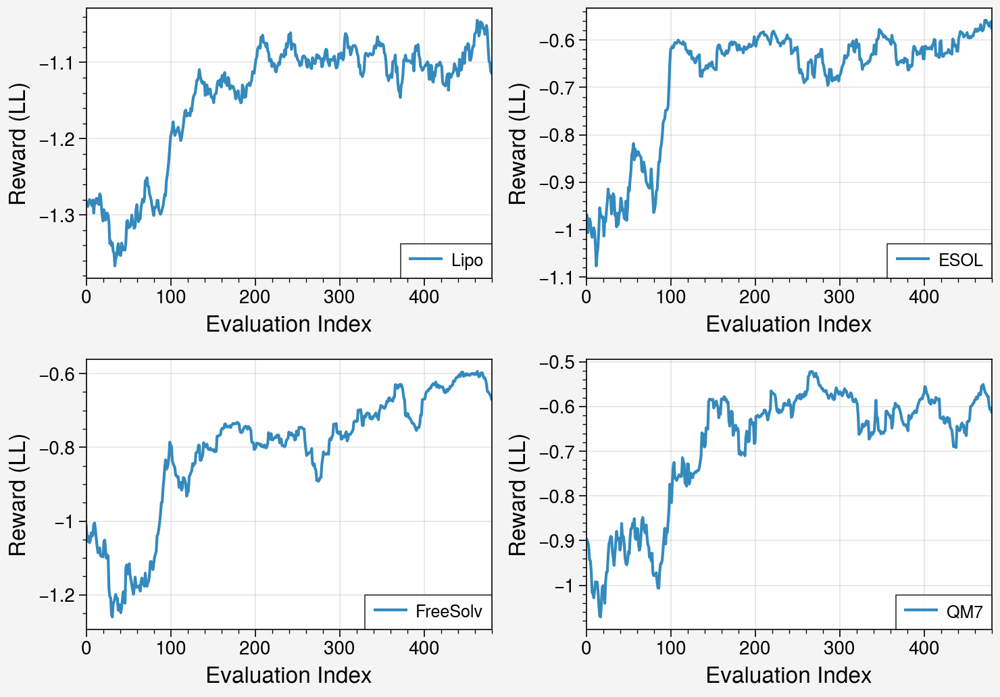

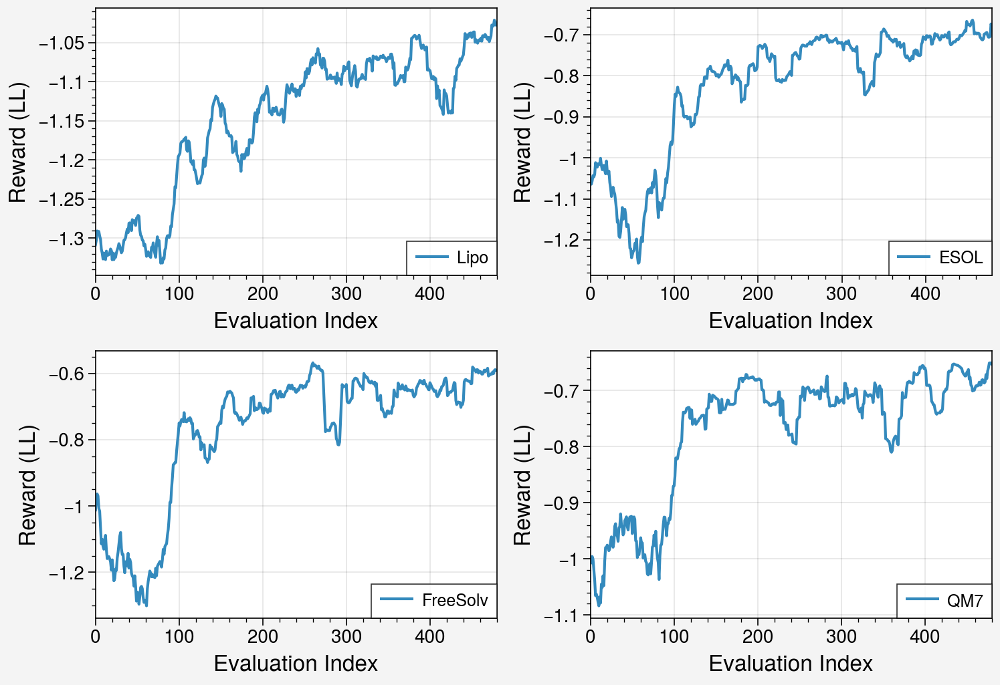

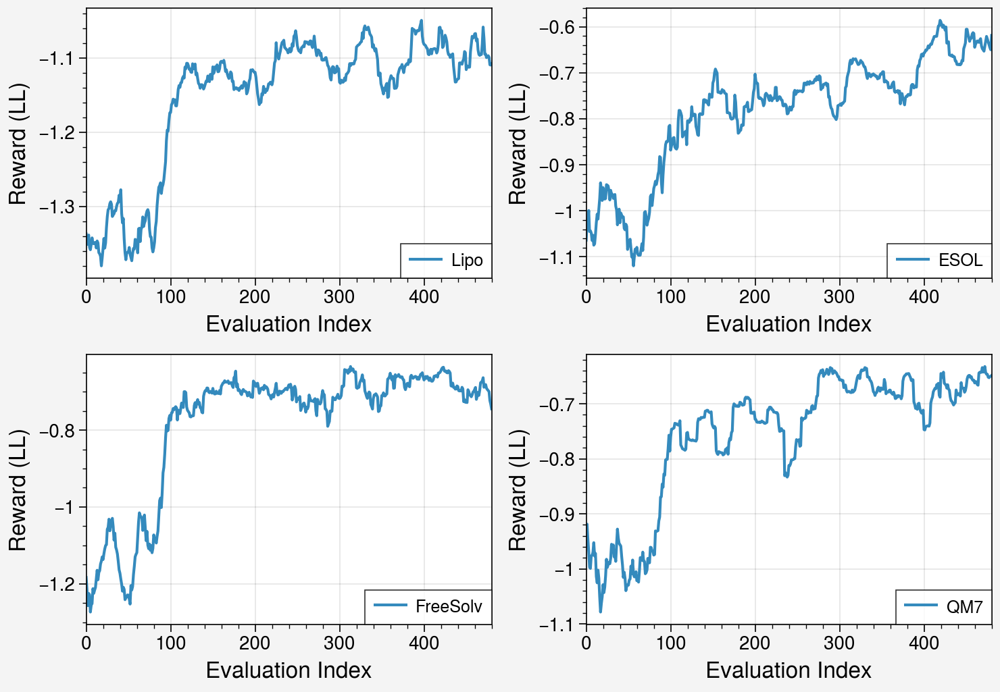

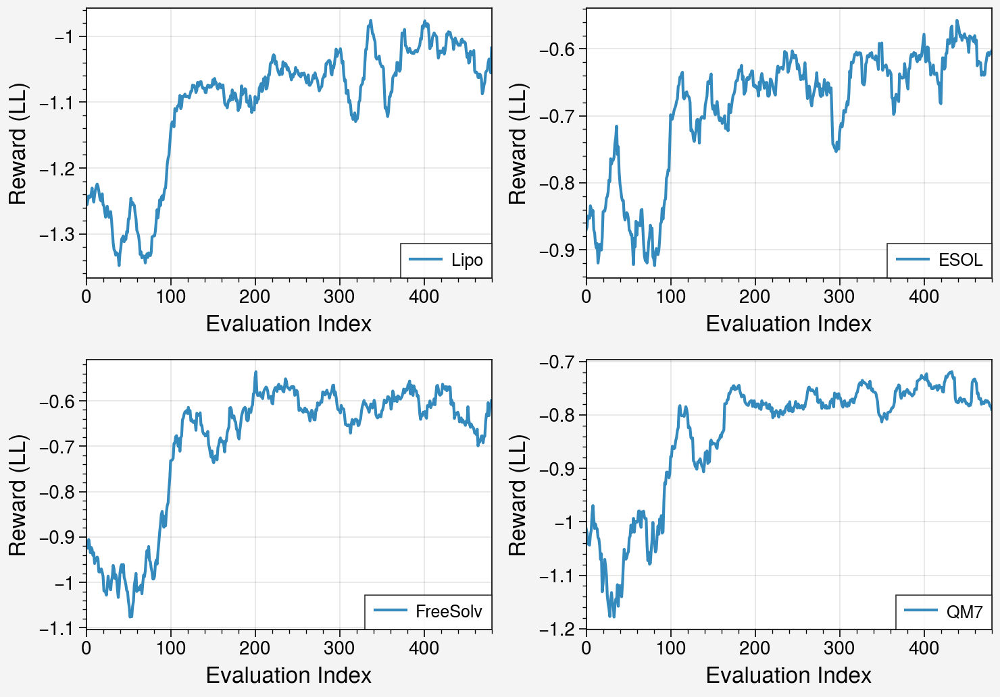

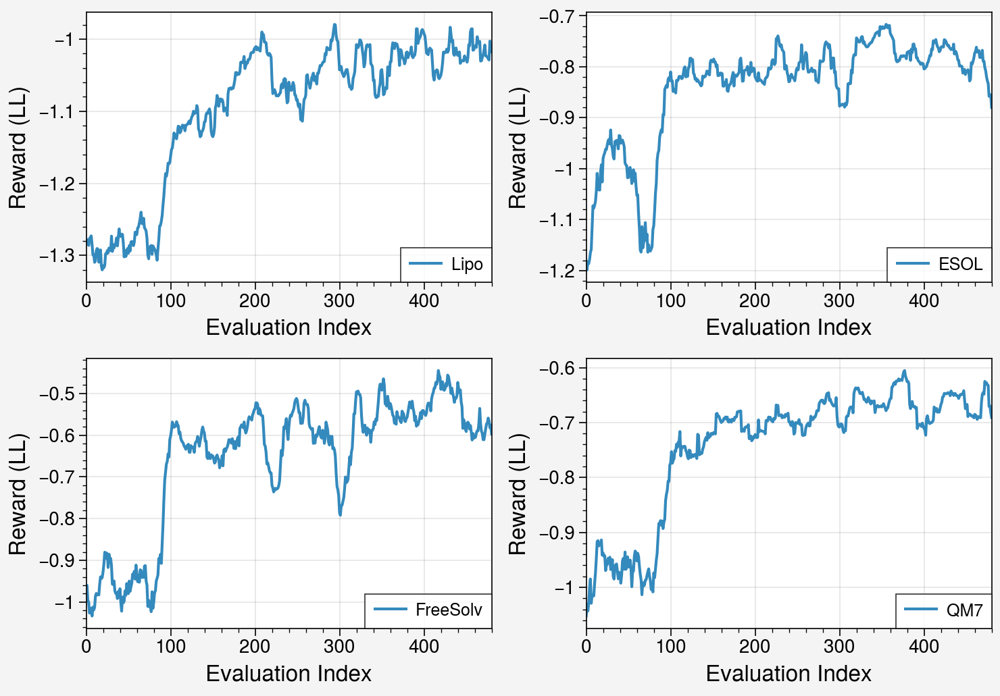

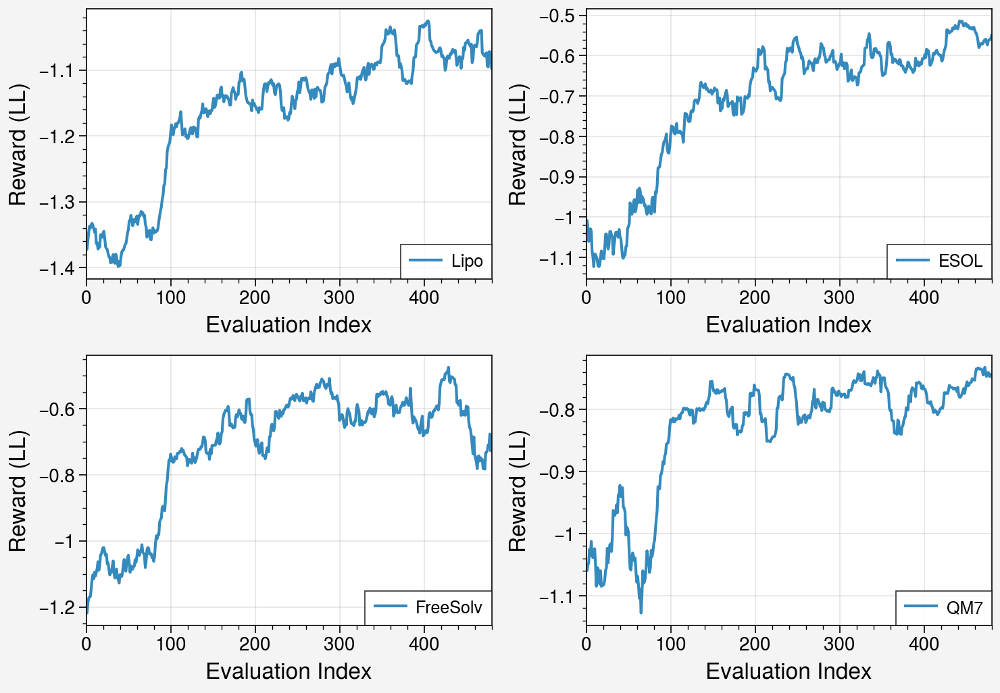

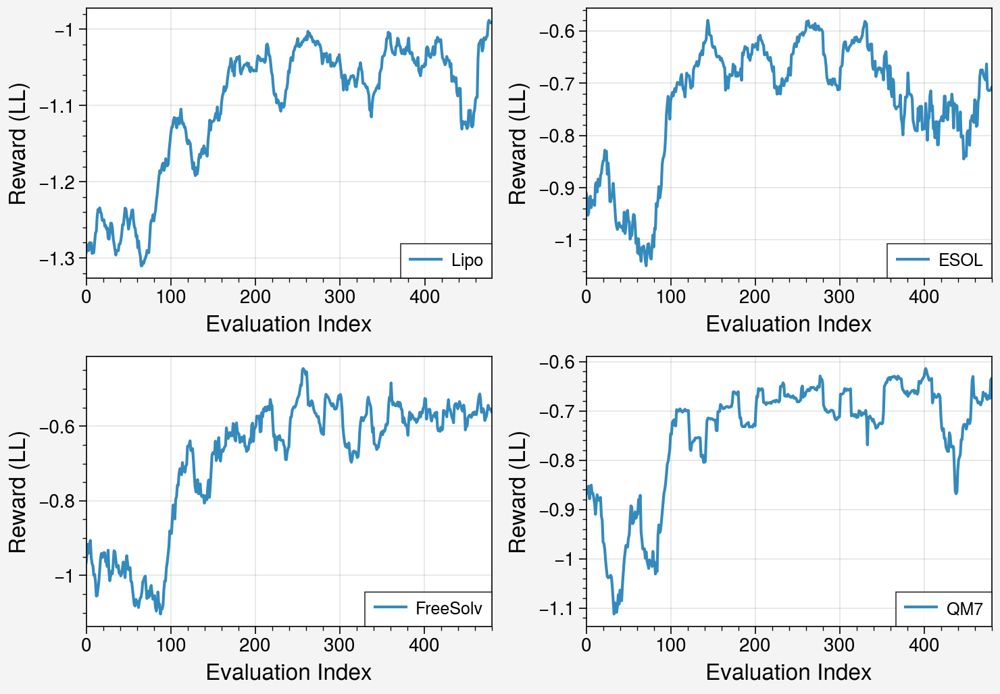

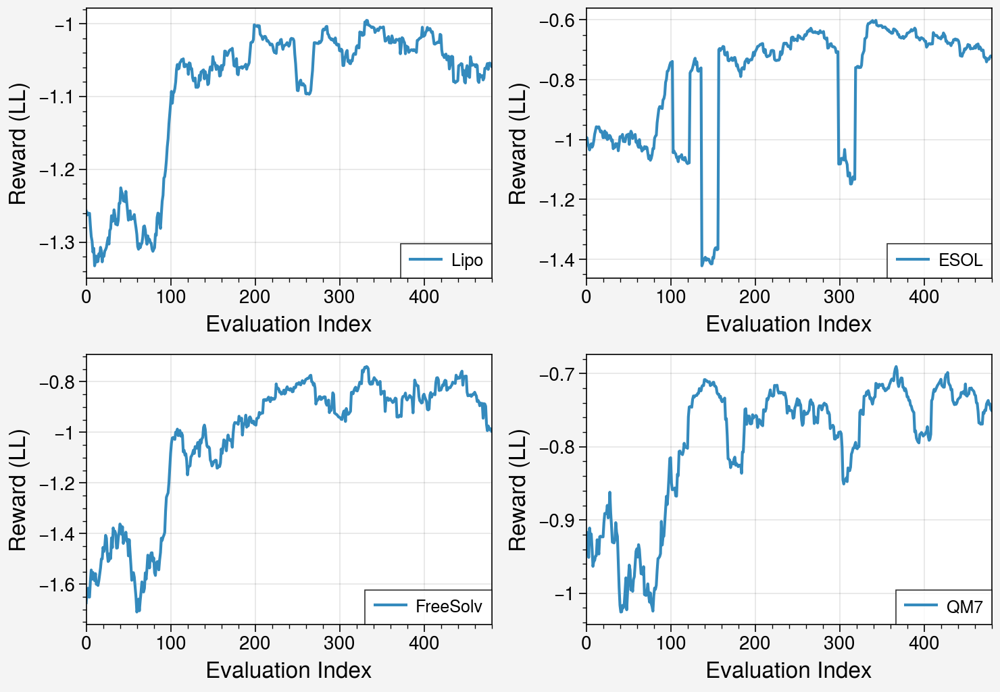

In [4]:
labels = ['Lipo', 'delaney', 'FreeSolv', 'QM7']

for seed in range(8):
    dataframes = [pd.read_csv(f'../result/NEW_RE_{label.lower()}_random_{seed}/results.csv') for label in labels]

    fig, ax = pplt.subplots(nrows=2, ncols=2, share=False, refwidth=3, refheight=2)

    for idx, df in enumerate(dataframes):
        objective_smoothed = np.convolve(df.objective.values, np.ones(20)/20, mode='valid')
        evaluation_index = np.arange(len(objective_smoothed))

        ax[idx].plot(evaluation_index, objective_smoothed, label=NAME[idx], color=COLOR[1])
        ax[idx].legend(loc=4)
        ax[idx].format(
            xlabel='Evaluation Index', ylabel='Reward (LL)',
            xticklabelsize=10, yticklabelsize=10, xlabelsize=12, ylabelsize=12
        )

    fig.save(f'../fig/search_reward_{seed}.png', dpi=300, bbox_inches='tight')

### 1.2 Search reward mean and standard deviation across 8 random seeds

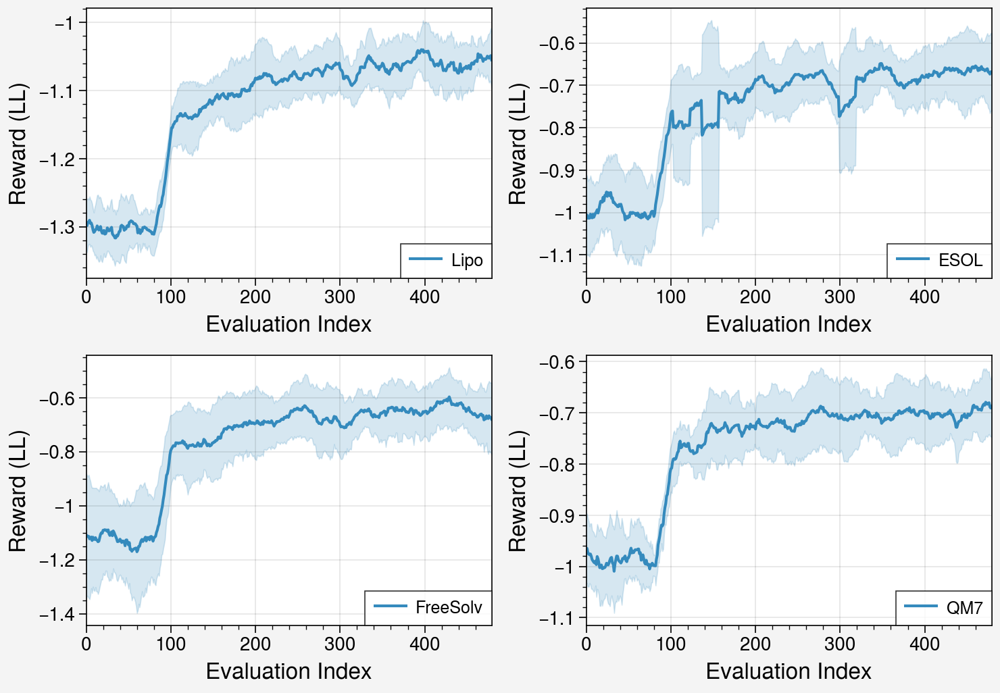

In [6]:
labels = ['Lipo', 'delaney', 'FreeSolv', 'QM7']
nseeds = 8

all_objectives = [[[] for _ in range(nseeds)] for _ in range(len(labels))]

for seed in range(nseeds):
    dataframes = [pd.read_csv(f'../result/NEW_RE_{label.lower()}_random_{seed}/results.csv') for label in labels]
    for idx, df in enumerate(dataframes):
        objective_smoothed = np.convolve(df.objective.values, np.ones(20)/20, mode='valid')
        all_objectives[idx][seed] = objective_smoothed[:480]
        

fig, ax = pplt.subplots(nrows=2, ncols=2, share=False, refwidth=3, refheight=2)


for idx, objectives in enumerate(all_objectives):
    mean_objective = np.mean(objectives, axis=0)
    std_objective = np.std(objectives, axis=0)
    evaluation_index = np.arange(len(mean_objective))

    ax[idx].plot(evaluation_index, mean_objective, label=NAME[idx], color=COLOR[1])
    ax[idx].fill_between(evaluation_index, mean_objective - std_objective, mean_objective + std_objective, alpha=0.2, color=COLOR[1])
    ax[idx].legend(loc=4)
    ax[idx].format(
        xlabel='Evaluation Index', ylabel='Reward (LL)',
        xticklabelsize=10, yticklabelsize=10, xlabelsize=12, ylabelsize=12
    )
    
fig.save('../fig/search_reward.png', dpi=300, bbox_inches='tight')

## 2. UQ Metrics
### 2.1 Benchmark results

https://github.com/lhirschfeld/ChempropUncertaintyQuantification/blob/master/uncertainty_evaluation/evaluations.csv


In [2]:
def benchmark_result(dataset='Delaney', estimator='MPNN Ensemble'):
    """Load benchmark result for a specific dataset and machine learning method.

    Args:
        dataset (str, optional): The name of the dataset. Defaults to 'Delaney'.
        estimator (str, optional): The name of the machine learning method. Defaults to 'MPNN Ensemble'.

    Returns:
        DataFrame: A DataFrame containing the benchmark result for the specified dataset and estimator.
    """
    benchmark = pd.read_csv('./benchmark_result.csv')
    benchmark = benchmark[
        (benchmark['Data Set'] == dataset) &
        (benchmark['Estimator'] == estimator) &
        (benchmark['Split'] == 'Random Split')
    ]

    return benchmark

### 2.2 AUTOGNNUQ results


In [3]:
def autognn_result(dataset='Delaney', total_unc=True, which="best"):
    """A function to load autognn uncertainty quantification result.

    Args:
        dataset (str, optional): dataset name. Defaults to 'Delaney'.
        total_unc (bool, optional): if use total uncertainty. Defaults to True.

    Returns:
        dict: result
    """
    y_test, y_loc, y_scale, y_loss = [], [], [], []
    y_val, y_loc_val, y_scale_val = [], [], []
    spearman, mca, nll, cnll, errs, errs_total = [], [], [], [], [], []
    mccurve = []

    # Load post-training results for 8 different random splits
    for i in range(8):
        y_test_, y_loc_, y_scale_, y_loss_, _, _, _, y_val_, y_loc_val_, y_scale_val_,  = load_post_training(
            dataset=dataset, data_path=f'../result/NEW_POST_RESULT/post_result_{dataset}_random_{i}/', seed=i, which=which)
        y_test.append(y_test_)
        y_loc.append(y_loc_)
        y_scale.append(y_scale_)
        y_loss.append(y_loss_)
        y_val.append(y_val_)
        y_loc_val.append(y_loc_val_)
        y_scale_val.append(y_scale_val_)

        # Calculate predictions and uncertainties for each split
        y_pred = y_loc[i].mean(axis=0)
        y_var = y_loc[i].var(axis=0) + (y_scale[i] ** 2).mean(axis=0) if total_unc else y_loc[i].var(axis=0)
        y_true = y_test[i]
        
        y_pred_val = y_loc_val[i].mean(axis=0)
        y_var_val = y_loc_val[i].var(axis=0) + (y_scale_val[i] ** 2).mean(axis=0) if total_unc else y_loc_val[i].var(axis=0)
        y_true_val = y_val[i]

        # Calculate evaluation metrics for each split
        spearman.append(spearmanr(y_var, np.abs(y_true - y_pred)).correlation)
        mca.append(miscal_area(y_var, y_pred, y_true)[0])
        mccurve.append(miscal_area(y_var, y_pred, y_true)[1])
        nll.append(NLL(y_var, y_pred, y_true))
        cnll.append(cNLL(y_var, y_pred, y_true, y_var_val, y_pred_val, y_true_val))
        errs.append(np.abs(y_true - y_pred))
        errs_total.append(np.abs(y_true - y_loc[i]))

    # Return a dictionary with all evaluation metrics
    return {'nll': nll, 'cnll': cnll, 'spearman': spearman, 'mca': mca, 'err': errs, 'err_total': errs_total, 'mccurve': mccurve, 'loss': y_loss}

In [4]:
if not os.path.exists('../result/NEW_RESULT.pickle'):
    # Load both results for multiple datasets
    result_best, result_worst, benchmark = [], [], []

    # Iterate through multiple datasets
    for dataset in ['lipo', 'Delaney', 'freesolv', 'QM7']:
        
        # Append result for the dataset using autognn_result function with total uncertainty
        result_best.append(autognn_result(dataset=dataset.lower(), total_unc=True, which="best"))
        result_worst.append(autognn_result(dataset=dataset.lower(), total_unc=True, which="worst"))
        
        # Append benchmark result for the dataset using benchmark_result function with estimator 'MPNN Ensemble'
        benchmark.append(benchmark_result(dataset=dataset, estimator='MPNN Ensemble'))

    with open("../result/NEW_RESULT.pickle", "wb") as handle:
        pickle.dump(result_best, handle)
        pickle.dump(result_worst, handle)
        pickle.dump(benchmark, handle)

In [5]:
with open("../result/NEW_RESULT.pickle", "rb") as handle:
    result = pickle.load(handle)
    result2 = pickle.load(handle)
    benchmark = pickle.load(handle)

### 2.3 UQ metrics AUTOGNNUQ vs benchmark

Average NLL
AUTOGNN  : 0.9737 1.1032 1.4495 5.6974
Benchmark: 12.8955 13.4378 13.9773 18.6217
% change : -92.45 -91.79 -89.63 -69.40

Average Calibrated NLL
AUTOGNN  : 1.1357 1.2193 1.5533 5.6801
Benchmark: 1.2972 1.3331 1.7296 10.2579
% change : -12.45 -8.54 -10.19 -44.63

Miscalibration Area
AUTOGNN  : 0.0605 0.0566 0.1064 0.2715
Benchmark: 0.3581 0.3327 0.3633 0.2457
% change : -83.10 -82.98 -70.72 10.53

Spearman's Coefficient
AUTOGNN  : 0.1632 0.2563 0.4240 0.6185
Benchmark: 0.1955 0.2127 0.2822 0.3939
% change : -16.52 20.49 50.24 57.02



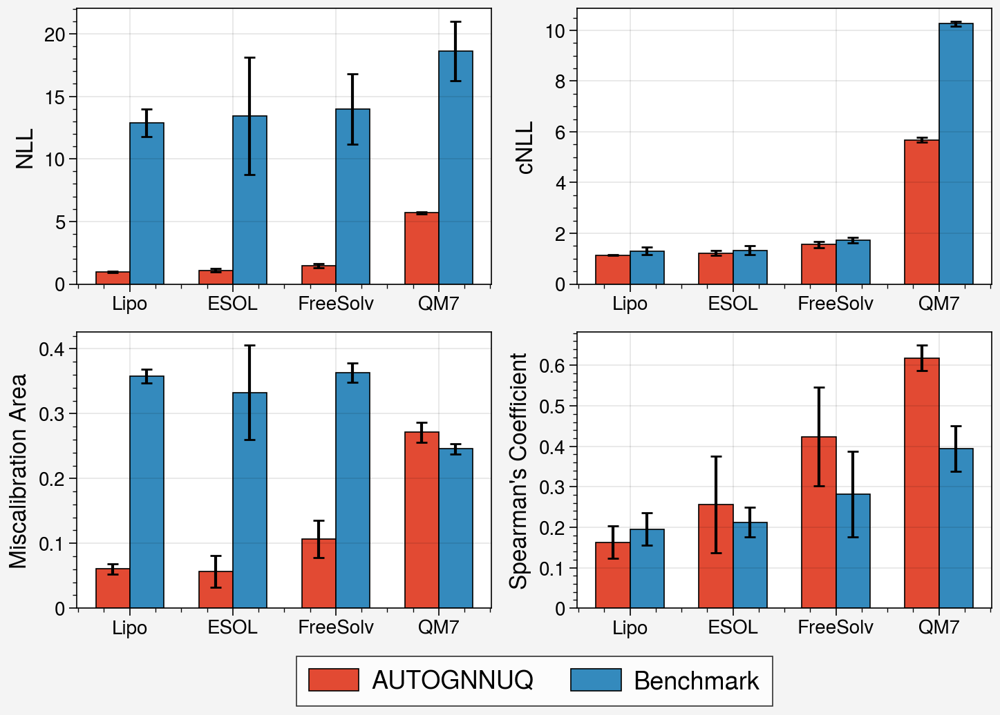

In [6]:
fig, ax = pplt.subplots(nrows=2, ncols=2, share=False, refwidth=3, refheight=2)

xx = np.arange(4) * 4

# Define function for plotting data
def plot_data(i, result_key, benchmark_key, ylabel):
    d1 = [result[j][result_key] for j in range(4)]
    d2 = [benchmark[j][benchmark_key] for j in range(4)]
    d1_mean = np.mean(d1, axis=1)
    d2_mean = np.mean(d2, axis=1)
    diff = np.divide(d1_mean - d2_mean, d2_mean) * 100
    print(benchmark_key)
    print(f'AUTOGNN  : {d1_mean[0]:0.4f} {d1_mean[1]:0.4f} {d1_mean[2]:0.4f} {d1_mean[3]:0.4f}')
    print(f'Benchmark: {d2_mean[0]:0.4f} {d2_mean[1]:0.4f} {d2_mean[2]:0.4f} {d2_mean[3]:0.4f}')
    print(f'% change : {diff[0]:0.2f} {diff[1]:0.2f} {diff[2]:0.2f} {diff[3]:0.2f}')
    print()
    if i == 0:
        ax[i].bar(xx-.66, np.mean(d1, axis=1), yerr=np.std(d1, axis=1), width=.33, label='AutoGNNUQ', edgecolor='k')
        ax[i].bar(xx+.66, np.mean(d2, axis=1), yerr=np.std(d2, axis=1), width=.33, label='Benchmark', edgecolor='k')
    else:
        ax[i].bar(xx-.66, np.mean(d1, axis=1), yerr=np.std(d1, axis=1), width=.33, edgecolor='k')
        ax[i].bar(xx+.66, np.mean(d2, axis=1), yerr=np.std(d2, axis=1), width=.33, edgecolor='k')
    ax[i].set_xticks(xx)
    ax[i].set_xticklabels(NAME)
    ax[i].format(ylabel=ylabel, xticklabelsize=10, yticklabelsize=10, xlabelsize=12, ylabelsize=12)


plot_data(0, 'nll', 'Average NLL', 'NLL')
plot_data(1, 'cnll', 'Average Calibrated NLL', 'cNLL')
plot_data(2, 'mca', 'Miscalibration Area', 'Miscalibration Area')
plot_data(3, 'spearman', "Spearman's Coefficient", "Spearman's Coefficient")

fig.legend(loc='b', fontsize=13)
plt.savefig('../fig/result.png', dpi=300, bbox_inches='tight')


## 3. Property prediction
### 3.1 Parity plots for 8 random seeds

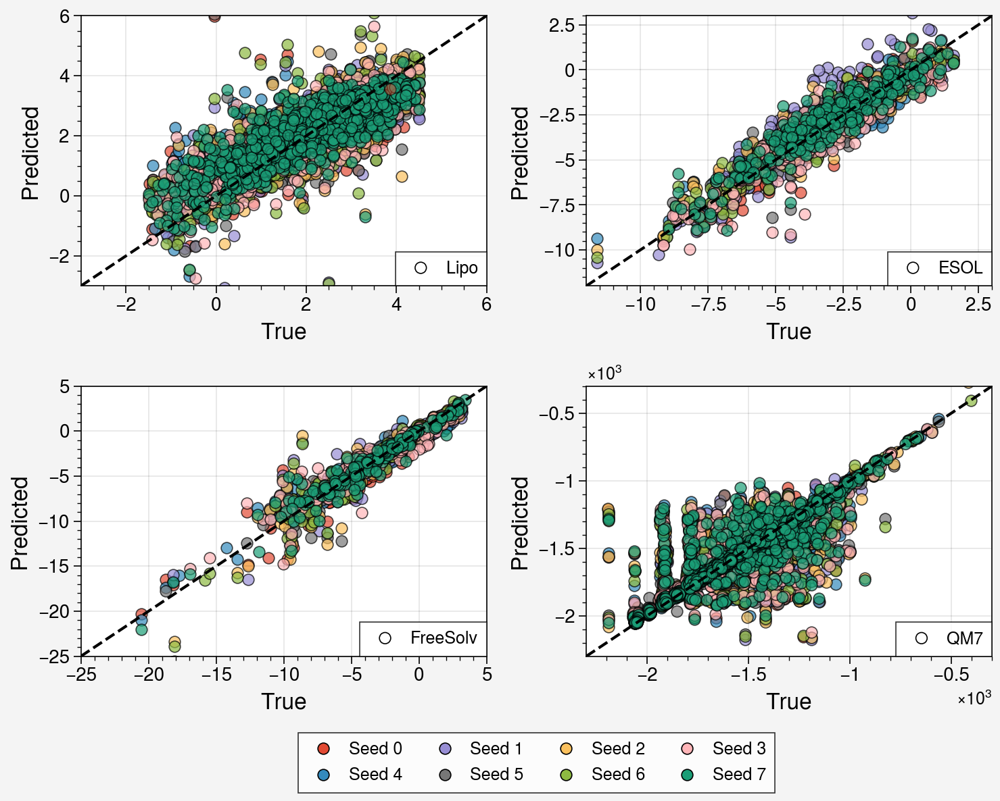

In [3]:
def parity(dataset, ax, vmin, vmax, label):
    hs1 = []
    
    for seed in range(8):
        data_path = f'../result/NEW_POST_RESULT/post_result_{dataset}_random_{seed}/'
        y_test, y_loc, _, _, _, _, _, _, _, _ = load_post_training(dataset=dataset, 
                                                                   data_path=data_path, 
                                                                   seed=seed)
        y_true = y_test
        y_pred = y_loc.mean(axis=0)
        
        if seed == 0:
            ax.scatter(y_true, y_pred, label=label, edgecolor='k', alpha=0.7, color=COLOR[seed])
            legend = ax.legend(loc=4)

            for legend_handle in legend.legendHandles:
                legend_handle.set_alpha(1)
                legend_handle.set_edgecolor('k')
                legend_handle.set_facecolor('none')
        else:
            ax.scatter(y_true, y_pred, edgecolor='k', alpha=0.7, color=COLOR[seed])
        
        if dataset == "lipo":
            h1 = ax.scatter(y_true[0], y_pred[0], label=f"Seed {seed}", edgecolor='k', alpha=0.5)
            hs1.append(h1)
        
    
    ax.plot([vmin, vmax], [vmin, vmax], '--', c='k')
    ax.set_xlim([vmin, vmax])
    ax.set_ylim([vmin, vmax])

    ax.format(xlabel='True', ylabel='Predicted',
                 xticklabelsize=10, yticklabelsize=10, xlabelsize=12, ylabelsize=12)
    
    return hs1

fig, ax = pplt.subplots(nrows=2, ncols=2, share=False, refwidth=3, refheight=2)

hs1 = parity(dataset='lipo', ax=ax[0], vmin=-3, vmax=6, label='Lipo')
_ = parity(dataset='delaney', ax=ax[1], vmin=-12, vmax=3, label='ESOL')
_ = parity(dataset='freesolv', ax=ax[2], vmin=-25, vmax=5, label='FreeSolv')
_ = parity(dataset='qm7', ax=ax[3], vmin=-2300, vmax=-300, label='QM7')

ax[-1].ticklabel_format(style='sci', axis='both', scilimits=(0,0))

legend = fig.legend(hs1, loc='b', ncols=4)


for i, legend_handle in enumerate(legend.legendHandles):
    legend_handle.set_facecolor(COLOR[i])
    legend_handle.set_alpha(1)
    legend_handle.set_edgecolor('k')

plt.savefig('../fig/parity.png', dpi=300, bbox_inches='tight')


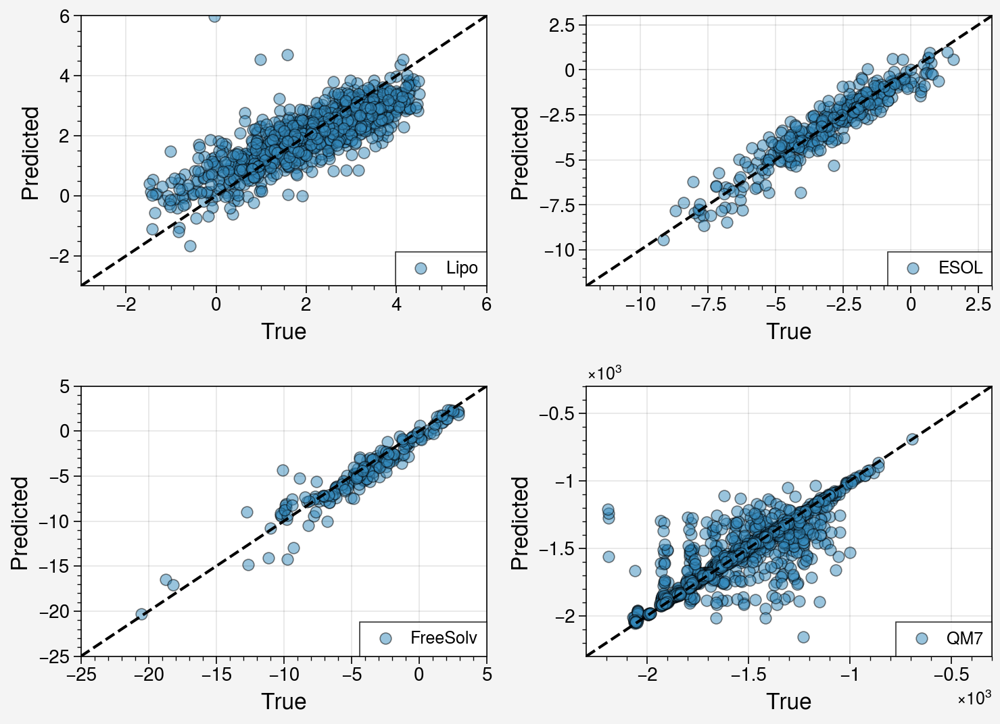

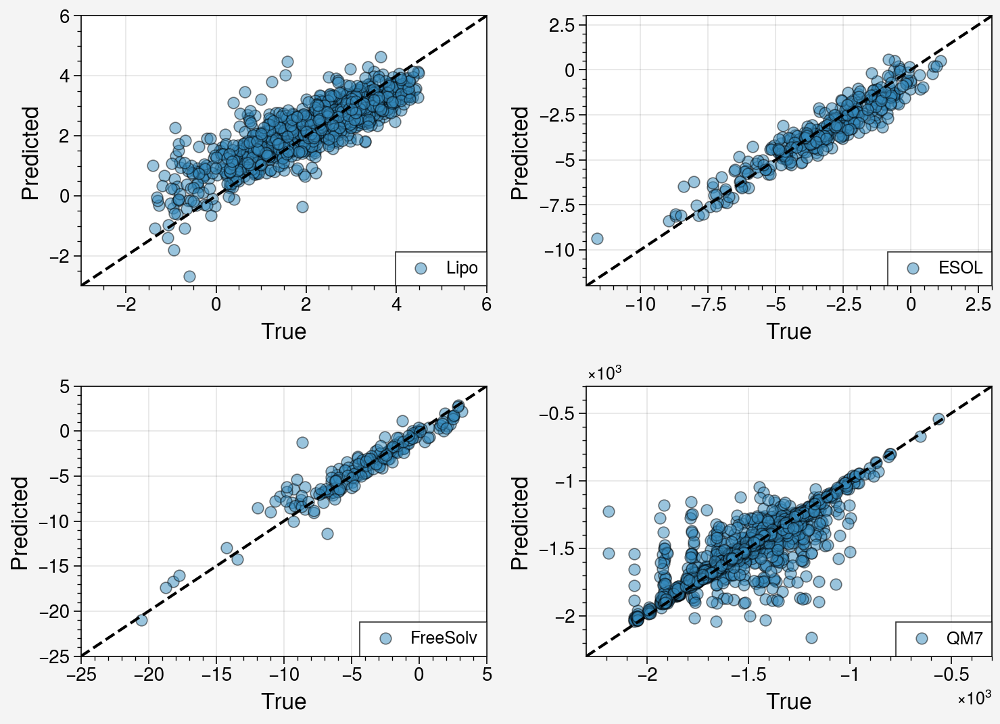

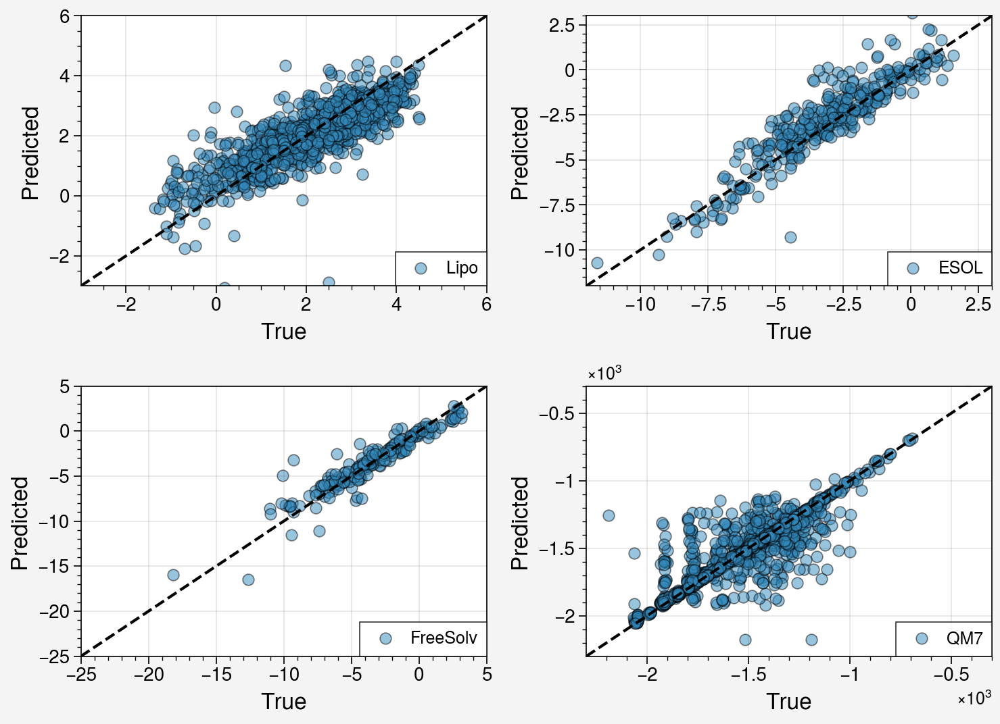

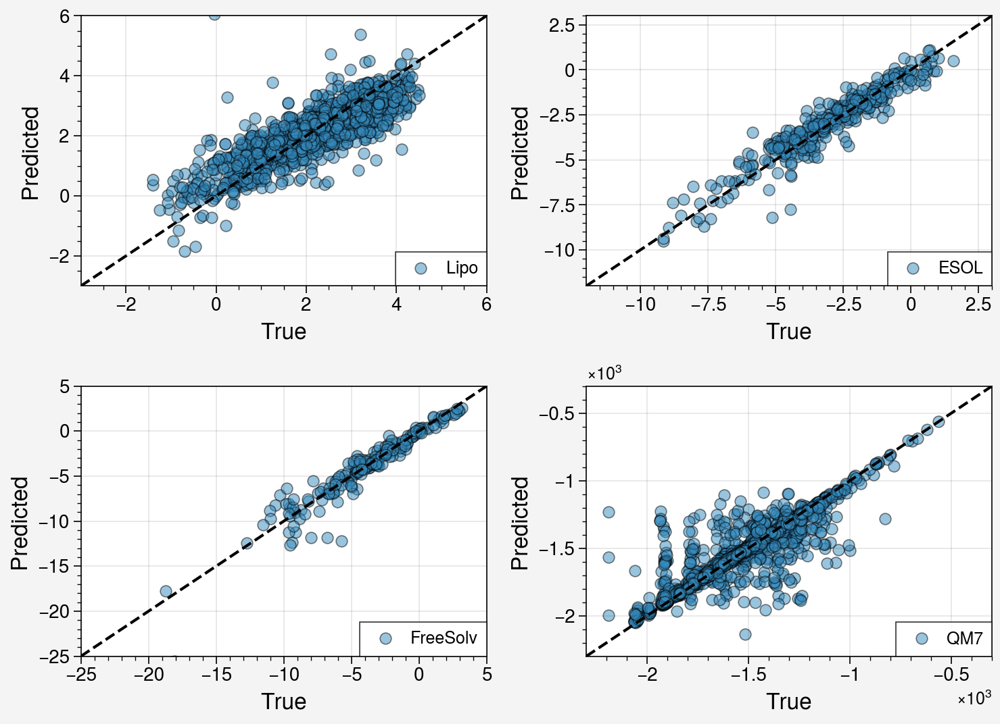

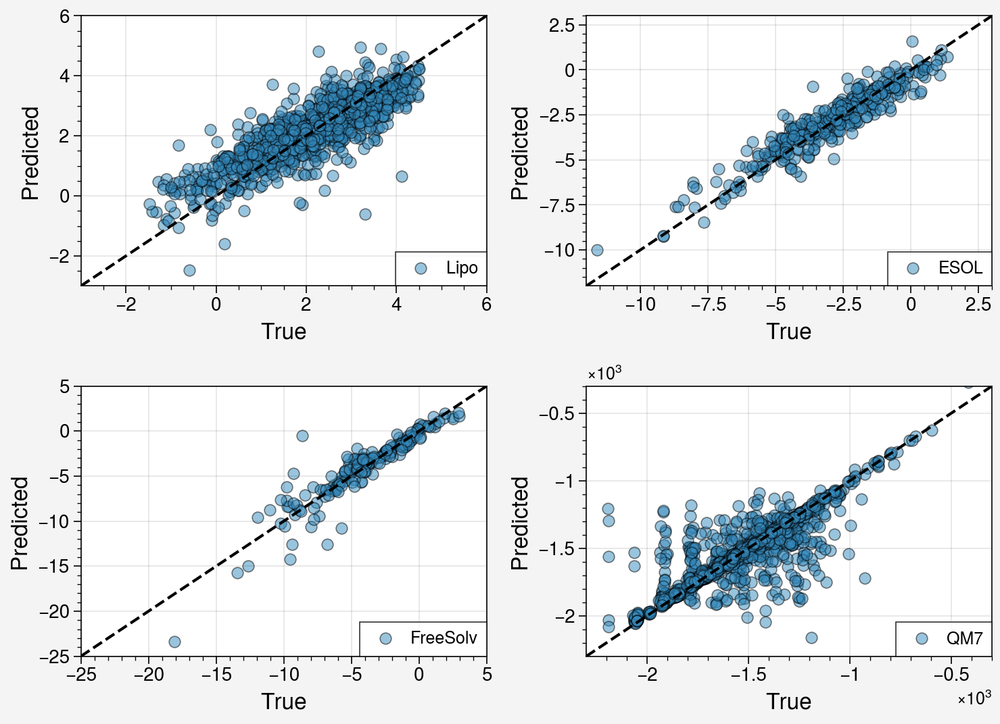

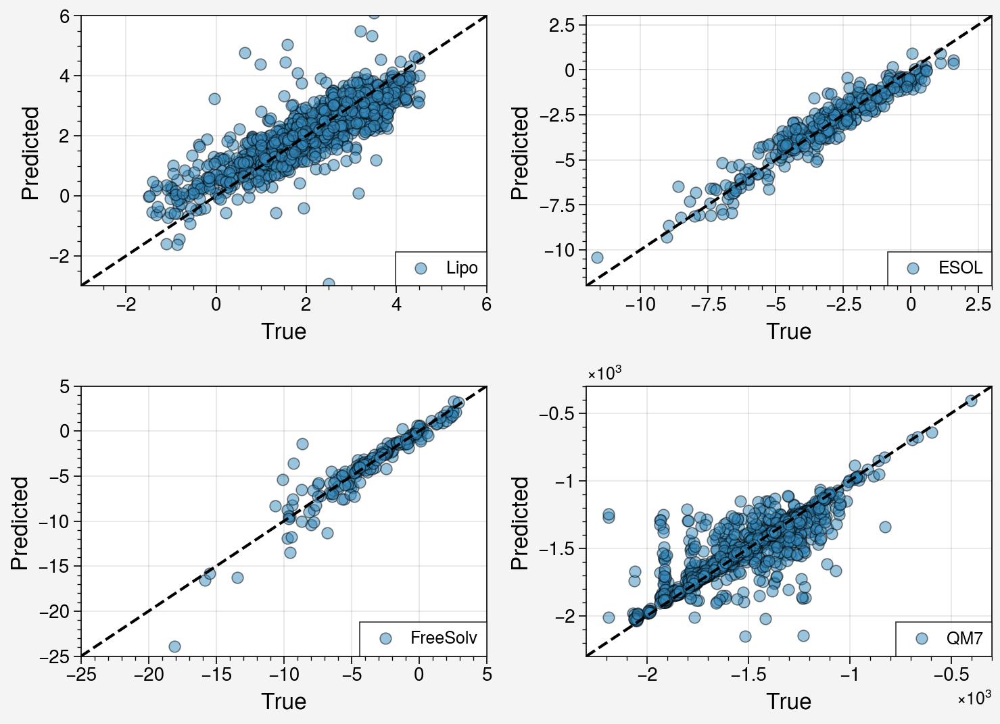

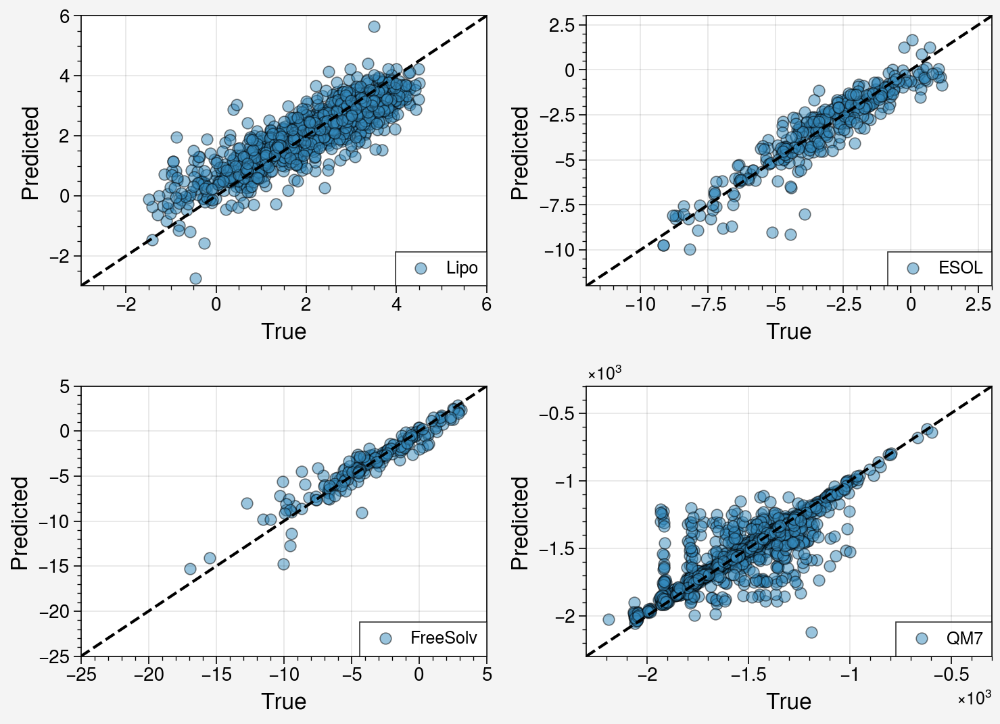

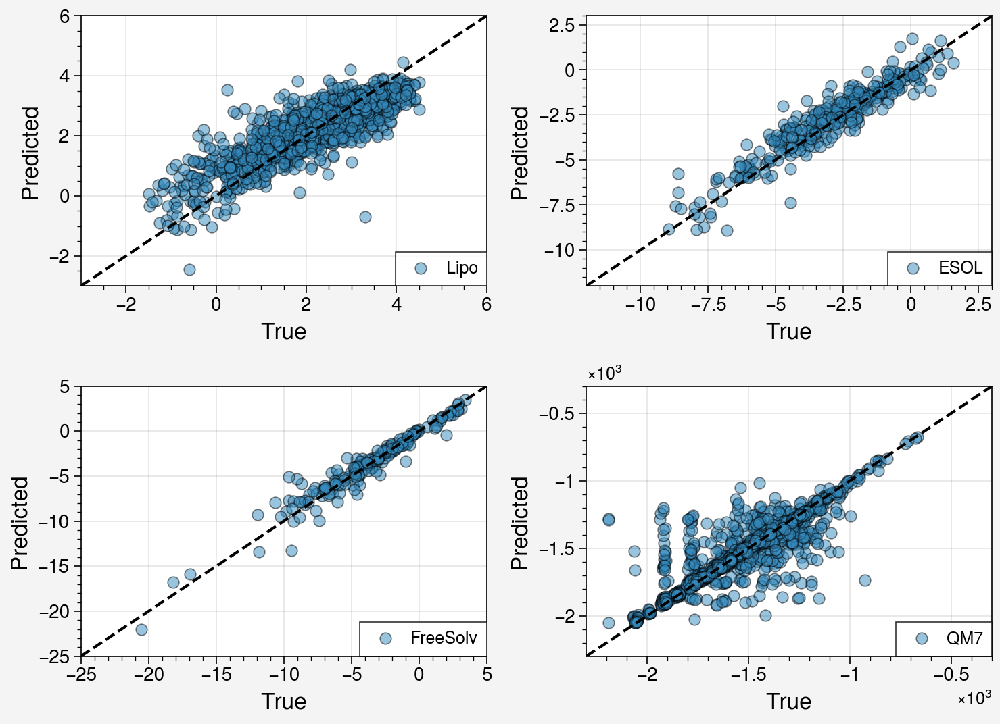

In [4]:
def parity_individual(dataset, ax, vmin, vmax, label, seed=0):
    
    data_path = f'../result/NEW_POST_RESULT/post_result_{dataset}_random_{seed}/'
    y_test, y_loc, _, _, _, _, _, _, _, _ = load_post_training(dataset=dataset, 
                                                               data_path=data_path,
                                                               seed=seed)
    y_true = y_test
    y_pred = y_loc.mean(axis=0)
    
    ax.scatter(y_true, y_pred, color=COLOR[1], label=label, edgecolor='k', alpha=0.5)
    ax.plot([vmin, vmax], [vmin, vmax], '--', c='k')
    ax.set_xlim([vmin, vmax])
    ax.set_ylim([vmin, vmax])
    ax.legend(loc=4)
    ax.format(xlabel='True', ylabel='Predicted',
                 xticklabelsize=10, yticklabelsize=10, xlabelsize=12, ylabelsize=12)


for seed in range(8):
    fig, ax = pplt.subplots(nrows=2, ncols=2, share=False, refwidth=3, refheight=2)

    parity_individual(dataset='lipo', ax=ax[0], vmin=-3, vmax=6, label='Lipo', seed=seed)
    parity_individual(dataset='delaney', ax=ax[1], vmin=-12, vmax=3, label='ESOL', seed=seed)
    parity_individual(dataset='freesolv', ax=ax[2], vmin=-25, vmax=5, label='FreeSolv', seed=seed)
    parity_individual(dataset='qm7', ax=ax[3], vmin=-2300, vmax=-300, label='QM7', seed=seed)

    ax[-1].ticklabel_format(style='sci', axis='both', scilimits=(0,0))

    plt.savefig(f'../fig/parity_seed_{seed}.png', dpi=300, bbox_inches='tight')

### 3.2 Property prediction AUTOGNNUQ vs MoleculeNet benchmark

In [8]:
def pred_metrics(dataset, seed=0):
    data_path = f'../result/NEW_POST_RESULT/post_result_{dataset}_random_{seed}/'
    y_test, y_loc, _, _, _, _, _, _, _, _ = load_post_training(dataset=dataset, 
                                                               data_path=data_path,
                                                               seed=seed)
    y_true = y_test
    y_pred = y_loc.mean(axis=0)
    
    mae_value = mae(y_true, y_pred)
    rmse_value = np.sqrt(mse(y_true, y_pred))
    r2_value = r2_score(y_true, y_pred)
    return mae_value, rmse_value, r2_value
    

metrics = {'lipo': [], 'delaney': [], 'freesolv': [], 'qm7': []}

for seed in range(8):
    for dataset in metrics.keys():
        mae_value, rmse_value, r2_value = pred_metrics(dataset=dataset, seed=seed)
        metrics[dataset].append((mae_value, rmse_value, r2_value))

for dataset, values in metrics.items():
    mae_values, rmse_values, r2_values = zip(*values)
    
    print(f'\nDataset: {dataset}')
    print(f'MAE:  {np.mean(mae_values):0.3f} +/- {np.std(mae_values):0.3f}')
    print(f'RMSE: {np.mean(rmse_values):0.3f} +/- {np.std(rmse_values):0.3f}')
    print(f'R2:   {np.mean(r2_values):0.3f} +/- {np.std(r2_values):0.3f}')



Dataset: lipo
MAE:  0.490 +/- 0.020
RMSE: 0.656 +/- 0.020
R2:   0.705 +/- 0.021

Dataset: delaney
MAE:  0.583 +/- 0.077
RMSE: 0.774 +/- 0.133
R2:   0.864 +/- 0.042

Dataset: freesolv
MAE:  0.794 +/- 0.059
RMSE: 1.261 +/- 0.122
R2:   0.895 +/- 0.025

Dataset: qm7
MAE:  48.120 +/- 2.424
RMSE: 108.623 +/- 3.081
R2:   0.761 +/- 0.013


## 4. Uncertainty Decomposition
### 4.1 Aleatoric vs epistemic for 8 random seeds

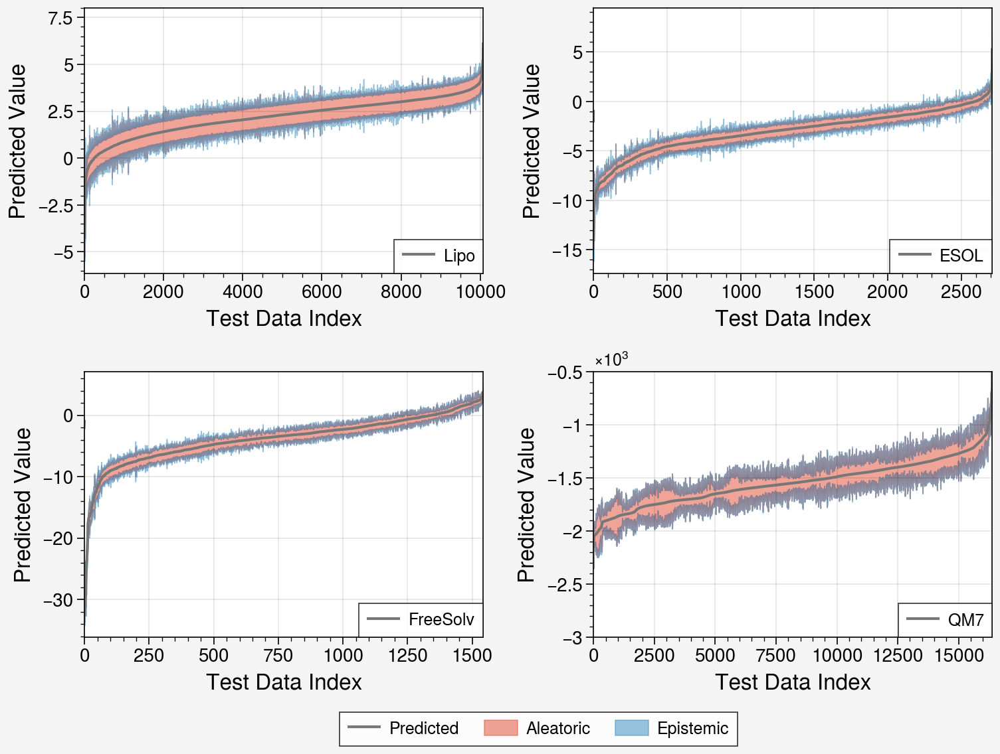

In [10]:
fig, ax = pplt.subplots(nrows=2, ncols=2, share=False, refwidth=3, refheight=2)

for i, name in enumerate(['lipo', 'delaney', 'freesolv', 'qm7']):
    aleatorics = []
    epistemics = []
    totals = []
    y_preds = []

    for seed in range(8):
        
        data_path = f'../result//NEW_POST_RESULT/post_result_{name}_random_{seed}/'
        y_test, y_loc, y_scale, y_loss, _, _, mol_test, _, _, _ = load_post_training(dataset=name, 
                                                                                     data_path=data_path,
                                                                                     seed=seed)

        y_true = y_test
        y_pred = y_loc.mean(axis=0)
        aleatoric = (y_scale**2).mean(axis=0)
        epistemic = y_loc.var(axis=0)
        total = aleatoric + epistemic
        aleatorics.append(aleatoric)
        epistemics.append(epistemic)
        totals.append(total)
        y_preds.append(y_pred)
        
    aleatoric = np.concatenate(aleatorics)
    epistemic = np.concatenate(epistemics)
    total = np.concatenate(totals)
    y_pred = np.concatenate(y_preds)
        
    idx = np.argsort(y_pred)
    xx = np.arange(len(idx))
    
    y_pred = y_pred[idx]
    aleatoric = aleatoric[idx]
    epistemic = epistemic[idx]
    total = total[idx]
    
    
    if name == 'qm7':
        aleatoric = np.convolve(aleatoric, np.ones(10)/10, mode="valid")
        epistemic = np.convolve(epistemic, np.ones(10)/10, mode="valid")
        total = np.convolve(total, np.ones(10)/10, mode="valid")
        y_pred = np.convolve(y_pred, np.ones(10)/10, mode="valid")
        xx = xx[:len(aleatoric)]
        
    ax[i].plot([-2, -1], [-2, -1], label=f'{NAME[i]}', color=COLOR[3])
    ax[i].legend(loc=4)
    
    if i == 0:
        ax[i].plot(xx, y_pred, label='Predicted', color=COLOR[3])
        ax[i].fill_between(xx, y_pred-aleatoric**0.5, y_pred +
                           aleatoric**0.5, alpha=0.5, color=COLOR[0], label='Aleatoric')
        ax[i].fill_between(xx, y_pred-total**0.5, y_pred -
                           aleatoric**0.5, alpha=0.5, color=COLOR[1], label='Epistemic')
    else:
        ax[i].plot(xx, y_pred, color=COLOR[3])
        ax[i].fill_between(xx, y_pred-aleatoric**0.5, y_pred +
                           aleatoric**0.5, alpha=0.5, color=COLOR[0])
        ax[i].fill_between(xx, y_pred-total**0.5, y_pred -
                           aleatoric**0.5, alpha=0.5, color=COLOR[1])
        
    ax[i].fill_between(xx, y_pred+total**0.5,
                       y_pred+aleatoric**0.5, alpha=0.5, color=COLOR[1])
    
    ax[i].set_xlim([0, xx[-1]])
    
    ax[i].format(xlabel='Test Data Index', ylabel='Predicted Value',
                 xticklabelsize=10, yticklabelsize=10, xlabelsize=12, ylabelsize=12)
    
    if i == 3:
        ax[i].ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    
handles, labels = ax[0].get_legend_handles_labels()

ax[3].set_ylim([-3000, -500])
fig.legend(handles[1:], loc='b');


plt.savefig(f'../fig/uncertainty.png', dpi=300, bbox_inches='tight')


### 4.2 Aleatoric and epistemic uncertainty CDF

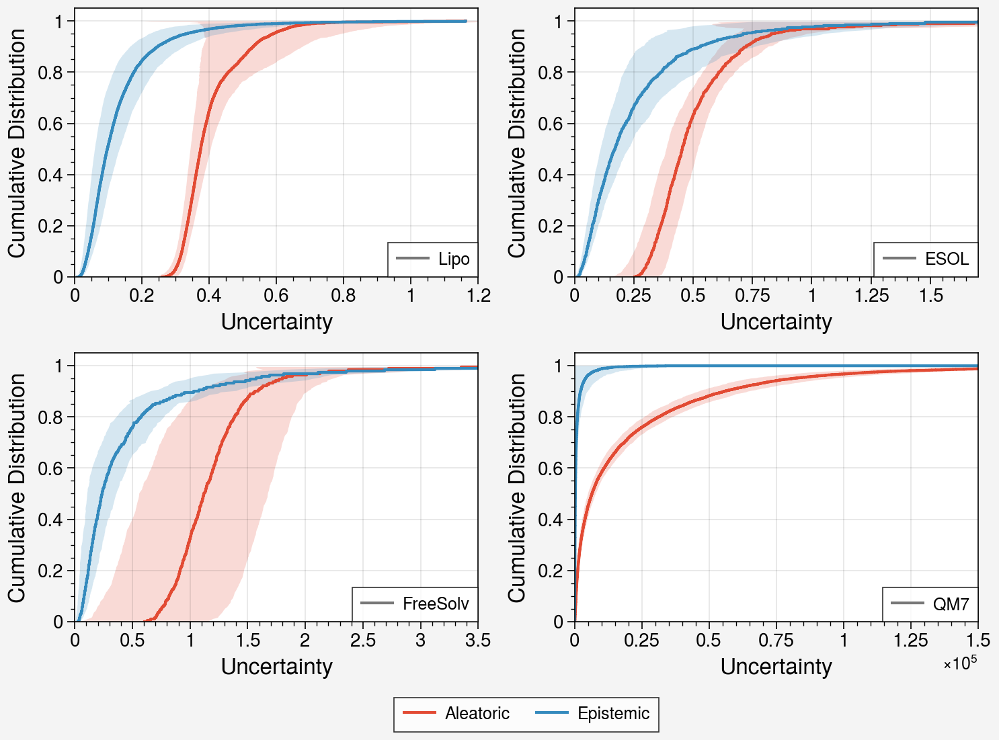

In [12]:
fig, ax = pplt.subplots(nrows=2, ncols=2, share=False, refwidth=3, refheight=2)

vmax = [None, None, None, 150000]
for i, name in enumerate(['lipo', 'delaney', 'freesolv', 'qm7']):
    num_seeds = 8
    aleatoric_values = []
    epistemic_values = []
    for seed in range(num_seeds):
        data_path = f'../result/NEW_POST_RESULT/post_result_{name}_random_{seed}/'
        y_test, y_loc, y_scale, y_loss, _, _, mol_test, _, _, _ = load_post_training(dataset=name, 
                                                                                     data_path=data_path,
                                                                                     seed=seed)

        y_true = y_test
        y_pred = y_loc.mean(axis=0)
        aleatoric = (y_scale**2).mean(axis=0)
        epistemic = y_loc.var(axis=0)
        total = aleatoric + epistemic
    
        aleatoric_values.append(aleatoric)
        epistemic_values.append(epistemic)
            
    aleatoric_values = np.array(aleatoric_values)
    epistemic_values = np.array(epistemic_values)
    sorted_aleatoric_y = []

    for c in range(8):
        val = aleatoric_values[c]
        sort_indices = np.argsort(val)
        sorted_aleatoric_mean = val[sort_indices]
        cdf_values = np.linspace(0, 1, len(sorted_aleatoric_mean))
        sorted_aleatoric_y.append(sorted_aleatoric_mean)
        
    sorted_aleatoric_y = np.array(sorted_aleatoric_y)[:-1]
    sorted_aleatoric_mean = np.mean(sorted_aleatoric_y, axis=0)[:-1]
    sorted_aleatoric_std = np.std(sorted_aleatoric_y, axis=0)[:-1]

    lower_bound = sorted_aleatoric_mean - sorted_aleatoric_std
    upper_bound = sorted_aleatoric_mean + sorted_aleatoric_std
    
    sorted_epistemic_y = []
    for c in range(8):
        val = epistemic_values[c]
        sort_indices2 = np.argsort(val)
        sorted_epistemic_mean = val[sort_indices2]
        cdf_values2 = np.linspace(0, 1, len(sorted_epistemic_mean))
        sorted_epistemic_y.append(sorted_epistemic_mean)
        
    sorted_epistemic_y = np.array(sorted_epistemic_y)[:-1]
    sorted_epistemic_mean = np.mean(sorted_epistemic_y, axis=0)[:-1]
    sorted_epistemic_std = np.std(sorted_epistemic_y, axis=0)[:-1]

    lower_bound = sorted_aleatoric_mean - sorted_aleatoric_std
    upper_bound = sorted_aleatoric_mean + sorted_aleatoric_std
    lower_bound2 = sorted_epistemic_mean - sorted_epistemic_std
    upper_bound2 = sorted_epistemic_mean + sorted_epistemic_std

    if sorted_aleatoric_mean[-1] > sorted_epistemic_mean[-1]:
        sorted_epistemic_mean = np.append(sorted_epistemic_mean, sorted_aleatoric_mean[-1])
        cdf_values2 = np.append(cdf_values2, cdf_values[-1])
    else:
        sorted_aleatoric_mean = np.append(sorted_aleatoric_mean, sorted_epistemic_mean[-1])
        cdf_values = np.append(cdf_values, cdf_values2[-1])
    
    ax[i].plot([-2, -1], [-2, -1], label=f'{NAME[i]}', color=COLOR[3])
    ax[i].legend(loc=4)
    
    if i == 0:
        ax[i].plot(sorted_aleatoric_mean, cdf_values[:-1], drawstyle='steps-post', label='Aleatoric')
        ax[i].plot(sorted_epistemic_mean, cdf_values2[:-1], drawstyle='steps-post', label='Epistemic')
        ax[i].fill_betweenx(cdf_values[:len(lower_bound)], lower_bound, upper_bound, alpha=0.2)
        ax[i].fill_betweenx(cdf_values2[:len(lower_bound2)], lower_bound2, upper_bound2, alpha=0.2)

    else:
        ax[i].plot(sorted_aleatoric_mean, cdf_values[:-1], drawstyle='steps-post')
        ax[i].plot(sorted_epistemic_mean, cdf_values2[:-1], drawstyle='steps-post')
        ax[i].fill_betweenx(cdf_values[:len(lower_bound)], lower_bound, upper_bound, alpha=0.2)
        ax[i].fill_betweenx(cdf_values2[:len(lower_bound2)], lower_bound2, upper_bound2, alpha=0.2)
    
    ax[i].format(xlabel='Uncertainty', ylabel='Cumulative Distribution', ylim=[0, 1.05], xlim=[0, vmax[i]],
                 xticklabelsize=10, yticklabelsize=10, xlabelsize=12, ylabelsize=12)
    
    if i == 3:
        ax[i].ticklabel_format(style='sci', axis='x', scilimits=(0,0))

handles, labels = ax[0].get_legend_handles_labels()

ax[0].set_xlim([None, 1.2])
ax[1].set_xlim([None, 1.7])
ax[2].set_xlim([None, 3.5])

fig.legend(handles[1:], loc='b')

fig.save(f'../fig/uncertainty_cdf.png', dpi=300, bbox_inches='tight')

### 4.3 Absolute error vs epistemic uncertainty

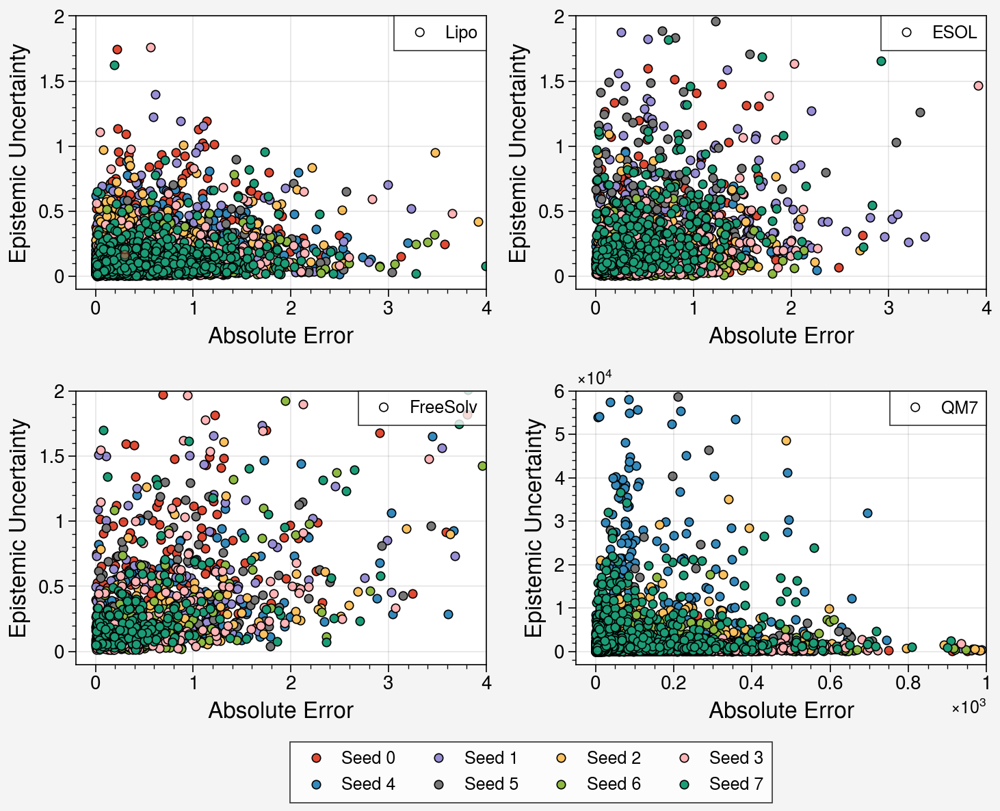

In [15]:
def unc_err(dataset, ax, vmin, vmax, label):
    hs1 = []
    
    for seed in range(8):
        data_path = f'../result/NEW_POST_RESULT/post_result_{dataset}_random_{seed}/'
        y_test, y_loc, y_scale, _, _, _, _, _, _, _ = load_post_training(dataset=dataset,  
                                                                         data_path=data_path, 
                                                                         seed=seed)

        y_true = y_test
        y_pred = y_loc.mean(axis=0)
        aleatoric = (y_scale**2).mean(axis=0)
        epistemic = y_loc.var(axis=0)

        err = np.abs(y_pred - y_true)
        
        if seed == 0:
            ax.scatter(err, epistemic, label=label, s=20, edgecolor='k', color=COLOR[seed])
            legend = ax.legend(loc="upper right")

            for legend_handle in legend.legendHandles:
                legend_handle.set_alpha(1)
                legend_handle.set_edgecolor('k')
                legend_handle.set_facecolor('none')
        else:
            ax.scatter(err, epistemic, s=20, edgecolor='k', color=COLOR[seed])
        
        if dataset == "lipo":
            h1 = ax.scatter(err[0], epistemic[0], label=f"Seed {seed}", edgecolor='k', s=20, alpha=0.5)
            hs1.append(h1)
        
    ax.set_xlim([vmin[0], vmax[0]])
    ax.set_ylim([vmin[1], vmax[1]])

    ax.format(xlabel='Absolute Error', ylabel='Epistemic Uncertainty',
                 xticklabelsize=10, yticklabelsize=10, xlabelsize=12, ylabelsize=12)
    
    return hs1


fig, ax = pplt.subplots(nrows=2, ncols=2, share=False, refwidth=3, refheight=2)

hs1 = unc_err(dataset='lipo', ax=ax[0], vmin=[-0.2, -0.1], vmax=[4, 2], label='Lipo')
_ = unc_err(dataset='delaney', ax=ax[1], vmin=[-0.2, -0.1], vmax=[4, 2], label='ESOL')
_ = unc_err(dataset='freesolv', ax=ax[2], vmin=[-0.2, -0.1], vmax=[4, 2], label='FreeSolv')
_ = unc_err(dataset='qm7', ax=ax[3], vmin=[-50, -3000], vmax=[1000, 60000], label='QM7')

ax[-1].ticklabel_format(style='sci', axis='both', scilimits=(0,0))

legend = fig.legend(hs1, loc='b', ncols=4)


for i, legend_handle in enumerate(legend.legendHandles):
    legend_handle.set_facecolor(COLOR[i])
    legend_handle.set_alpha(1)
    legend_handle.set_edgecolor('k')

plt.savefig('../fig/unc_err.png', dpi=300, bbox_inches='tight')


## 5. Molecular Uncertainty
### 5.1 t-SNE plot of epistemic uncertainty
MACCS keys http://www.mayachemtools.org/docs/modules/html/MACCSKeys.html

In [16]:
def extract_functional_groups(mol):
    fg_counts = Descriptors.MolWt(mol, True)
    fg_names = ["{}{}".format(fg[0], fg[1]) for fg in fg_counts.items()]
    return fg_names


def calculate_silhouette_score(data, k):
    model = KMeans(n_clusters=k, random_state=0)
    cluster_labels = model.fit_predict(data)
    silhouette_avg = silhouette_score(data, cluster_labels)
    return silhouette_avg

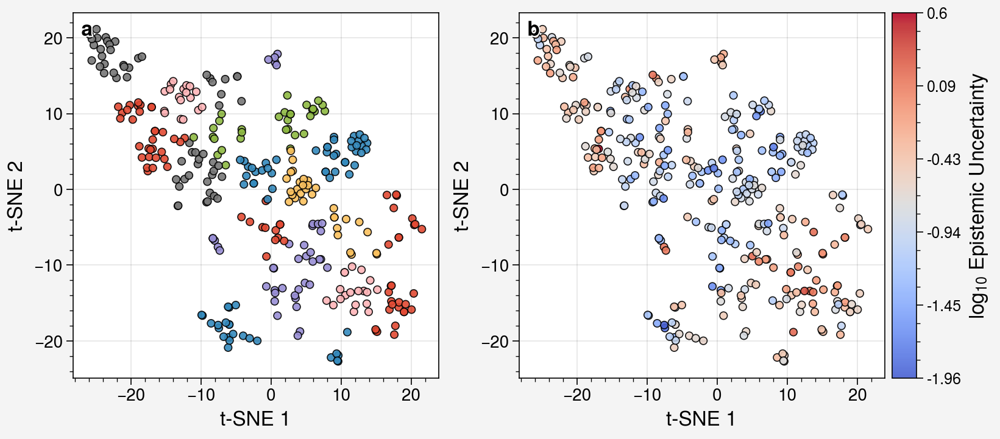

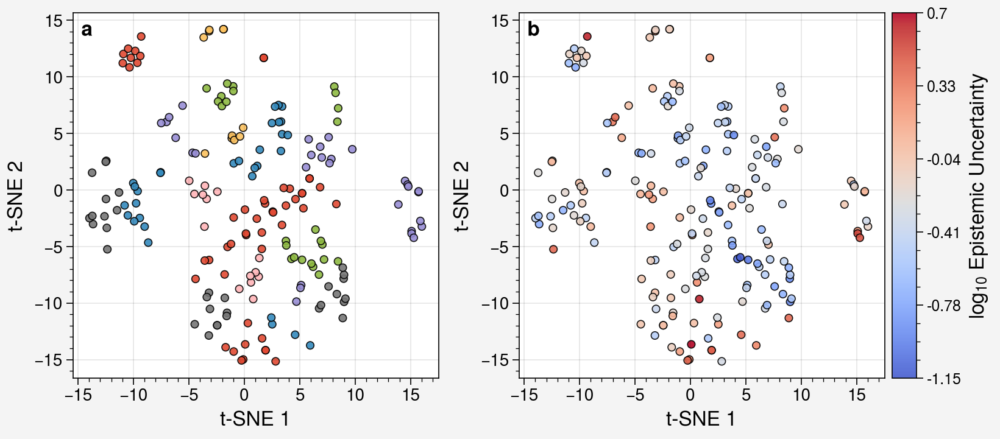

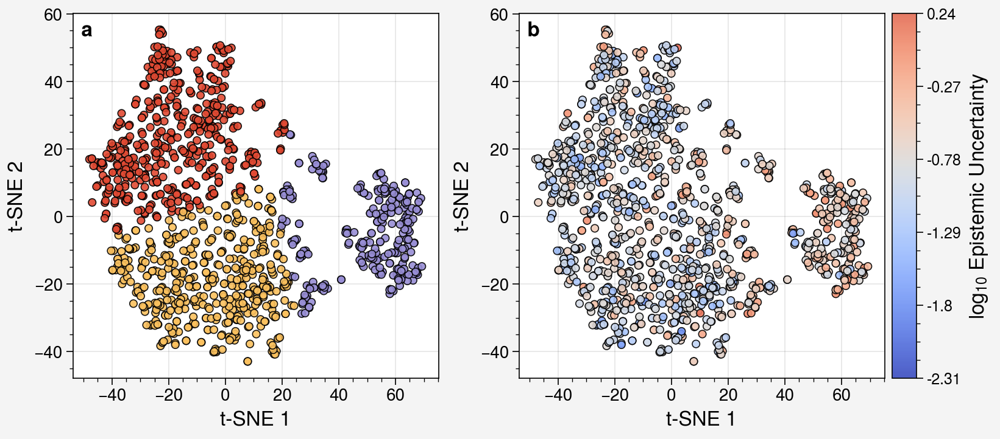

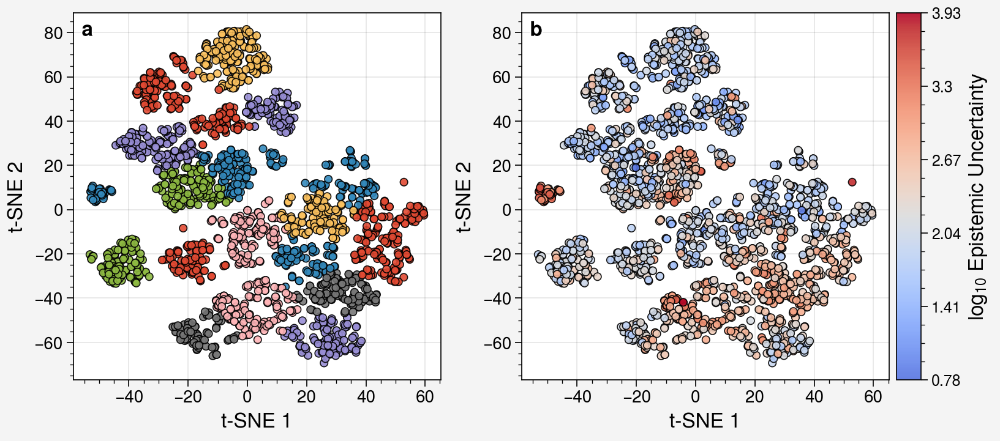

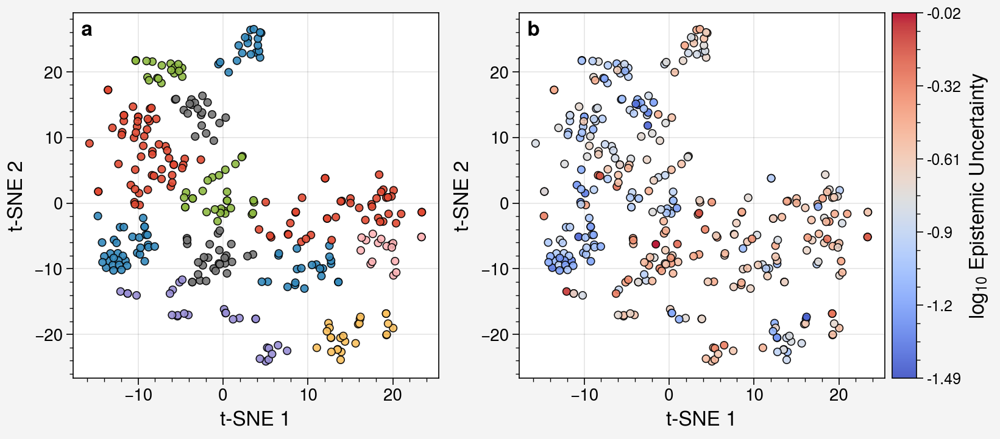

...

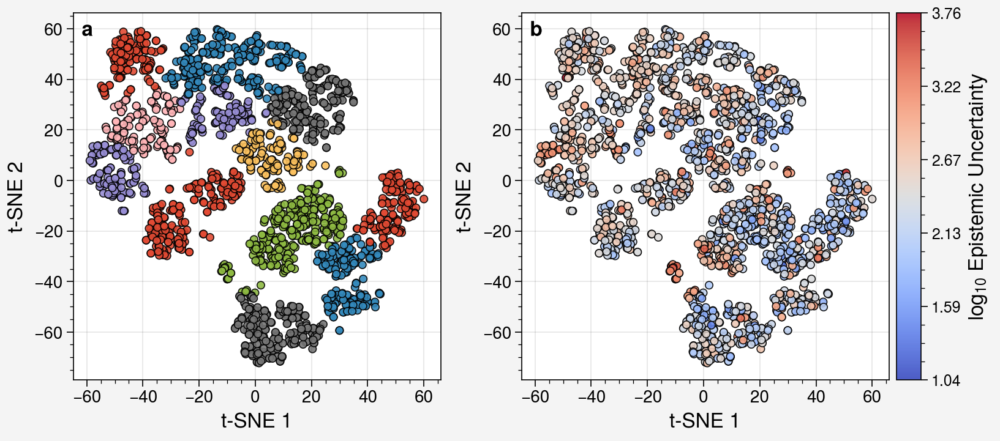

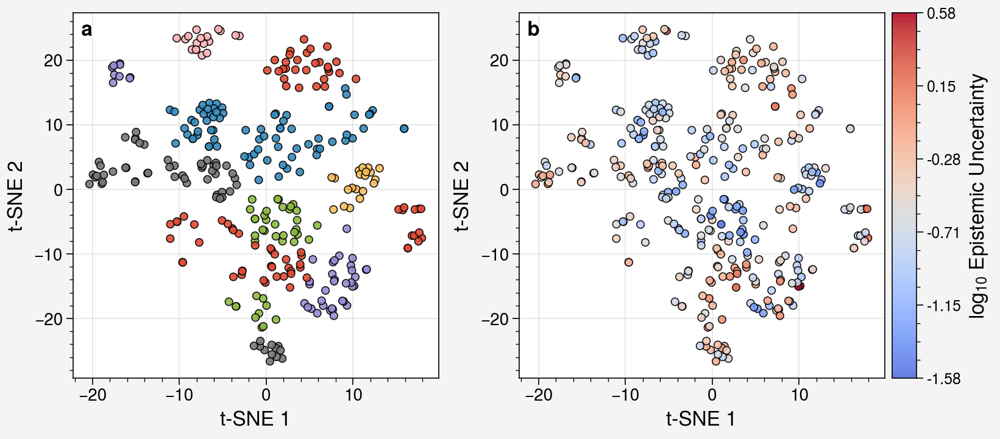

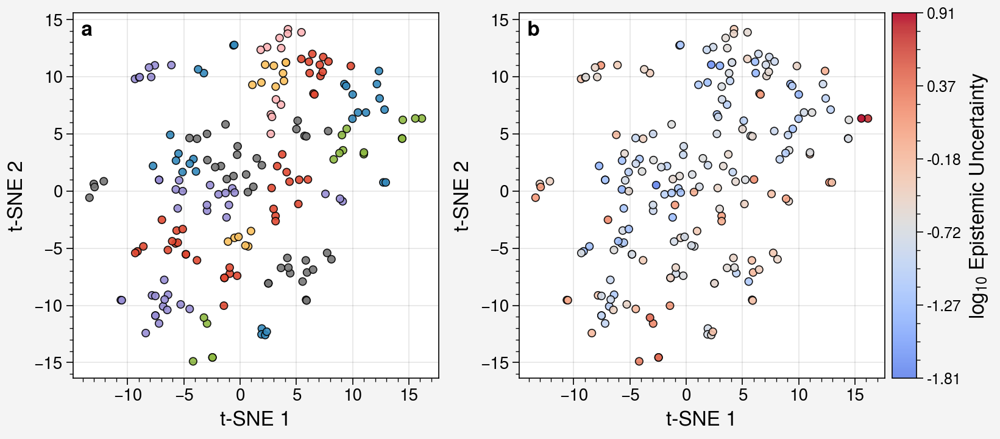

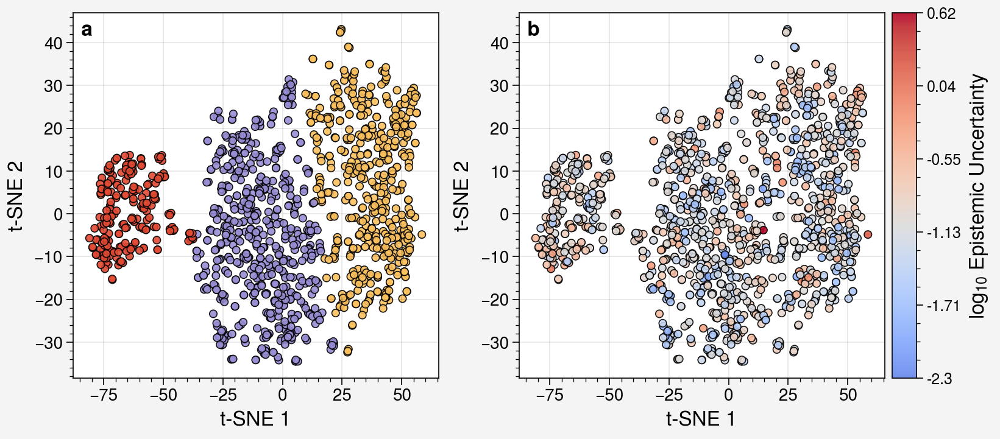

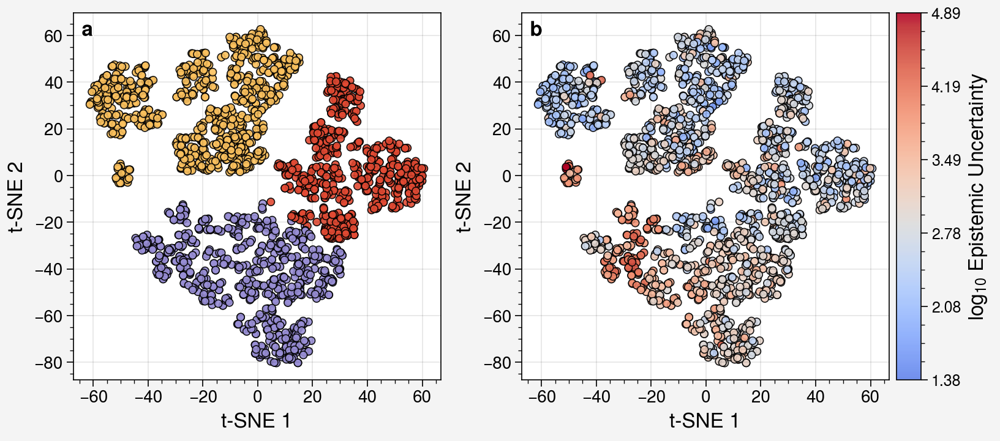

In [18]:
k_values = np.arange(3, 30)

for seed in range(8):
    for dataset in ['delaney', 'freesolv', 'lipo', 'qm7']:
        data_path = f'../result/NEW_POST_RESULT/post_result_{dataset}_random_{seed}/'
        y_test, y_loc, y_scale, y_loss, _, _, mol_test, _, _, _ = load_post_training(dataset=dataset, 
                                                                                     data_path=data_path, 
                                                                                     seed=seed)
        epistemic = y_loc.var(axis=0)
        mols = [Chem.MolFromSmiles(smi) for smi in mol_test]
        fps = [MACCSkeys.GenMACCSKeys(mol) for mol in mols]
        X = np.array(fps)
        
        tsne = TSNE(n_components=2, random_state=0, n_jobs=-1)
        X_tsne = tsne.fit_transform(X)

        epi = np.log10(epistemic)
        vmin = epi.min()
        vmax = epi.max()
        mean_epi = epi.mean()
        cmap = pplt.Colormap('coolwarm')

        silhouette_scores = [calculate_silhouette_score(X_tsne, k) for k in k_values]

        best_k = k_values[np.argmax(silhouette_scores)]

        kmeans = KMeans(n_clusters=best_k, random_state=0)
        clusters = kmeans.fit_predict(X_tsne)

        colors = (clusters - clusters.min()) / (clusters.max() - clusters.min())


        fig, ax = pplt.subplots(ncols=2, refwidth=3, share=False)

        im = ax[0].scatter(X_tsne[:, 0], X_tsne[:, 1], 
                   alpha=0.9, edgecolor='k', s=20,
                   c=clusters, cmap='ggplot')

        im = ax[1].scatter(X_tsne[:, 0], X_tsne[:, 1], 
                   alpha=0.9, edgecolor='k', s=20,
                   c=(epi-mean_epi), cmap='coolwarm')
        
        ticks = np.linspace((epi-mean_epi).min(), (epi-mean_epi).max(), num=6)
        cbar = fig.colorbar(im, ax=ax[1])
        cbar.set_label(r'log$_{10}$ Epistemic Uncertainty', size=12)
        cbar.set_ticks(ticks)
        cbar.set_ticklabels([str(round(tick+mean_epi, 2)) for tick in ticks])
        for i in range(2):
            ax[i].format(abc=['a','b'], abcloc="ul", abcsize=12, xlabel='t-SNE 1', ylabel='t-SNE 2',
                         xticklabelsize=10, yticklabelsize=10, xlabelsize=12, ylabelsize=12)


        fig.save(f'../fig/tsne_{dataset}_{seed}.png', dpi=300, bbox_inches='tight')


### 5.2 QM7 random seed 0 example molecules

In [18]:
dataset = 'qm7'
seed = 0

data_path = f'../result/NEW_POST_RESULT/post_result_{dataset}_random_{seed}/'
y_test, y_loc, y_scale, y_loss, _, _, mol_test, _, _, _ = load_post_training(dataset=dataset, 
                                                                                data_path=data_path, 
                                                                                seed=seed)
epistemic = y_loc.var(axis=0)
mols = [Chem.MolFromSmiles(smi) for smi in mol_test]
fps = [MACCSkeys.GenMACCSKeys(mol) for mol in mols]
X = np.array(fps)

tsne = TSNE(n_components=2, random_state=0, n_jobs=-1)
X_tsne = tsne.fit_transform(X)

epi = np.log10(epistemic)

In [44]:
molxx = mol_test[np.where(clusters == 14)[0][np.argsort(epi[np.where(clusters == 14)[0]])[-1]]]
molxx = Chem.MolFromSmiles(molxx)
drawer = rdMolDraw2D.MolDraw2DSVG(200, 200)
drawer.DrawMolecule(molxx)
drawer.FinishDrawing()
svg = drawer.GetDrawingText()
with open('../fig/qm7_high_14.svg', 'w') as f:
    f.write(svg)

In [45]:
molxx = mol_test[np.where(clusters == 8)[0][np.argsort(epi[np.where(clusters == 8)[0]])[-1]]]
molxx = Chem.MolFromSmiles(molxx)
drawer = rdMolDraw2D.MolDraw2DSVG(200, 200)
drawer.DrawMolecule(molxx)
drawer.FinishDrawing()
svg = drawer.GetDrawingText()
with open('../fig/qm7_high_8.svg', 'w') as f:
    f.write(svg)
    

In [46]:
molxx = mol_test[np.where(clusters == 18)[0][np.argsort(epi[np.where(clusters == 18)[0]])[-1]]]
molxx = Chem.MolFromSmiles(molxx)
drawer = rdMolDraw2D.MolDraw2DSVG(200, 200)
drawer.DrawMolecule(molxx)
drawer.FinishDrawing()
svg = drawer.GetDrawingText()
with open('../fig/qm7_high_18.svg', 'w') as f:
    f.write(svg)
    

In [47]:
molxx = mol_test[np.where(clusters == 1)[0][np.argsort(epi[np.where(clusters == 1)[0]])[1]]]
molxx = Chem.MolFromSmiles(molxx)
drawer = rdMolDraw2D.MolDraw2DSVG(200, 200)
drawer.DrawMolecule(molxx)
drawer.FinishDrawing()
svg = drawer.GetDrawingText()
with open('../fig/qm7_low_1.svg', 'w') as f:
    f.write(svg)
    

In [65]:
molxx = mol_test[np.where(clusters == 9)[0][np.argsort(epi[np.where(clusters == 9)[0]])[0]]]
molxx = Chem.MolFromSmiles(molxx)
drawer = rdMolDraw2D.MolDraw2DSVG(200, 200)
drawer.DrawMolecule(molxx)
drawer.FinishDrawing()
svg = drawer.GetDrawingText()
with open('../fig/qm7_low_9.svg', 'w') as f:
    f.write(svg)
    

In [66]:
molxx = mol_test[np.where(clusters == 19)[0][np.argsort(epi[np.where(clusters == 19)[0]])[1]]]
molxx = Chem.MolFromSmiles(molxx)
drawer = rdMolDraw2D.MolDraw2DSVG(200, 200)
drawer.DrawMolecule(molxx)
drawer.FinishDrawing()
svg = drawer.GetDrawingText()
with open('../fig/qm7_low_19.svg', 'w') as f:
    f.write(svg)

## 6. Architecture Discovered in Search
### 6.1 Best architectures

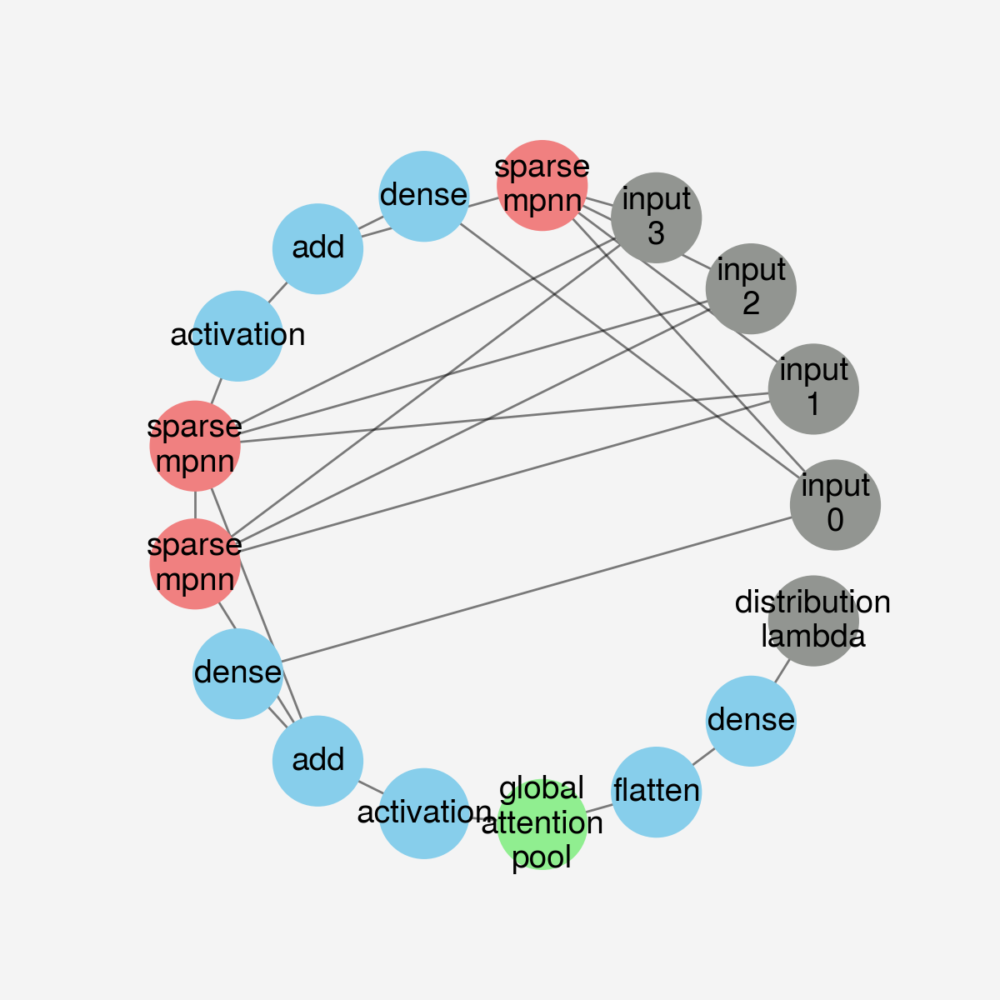

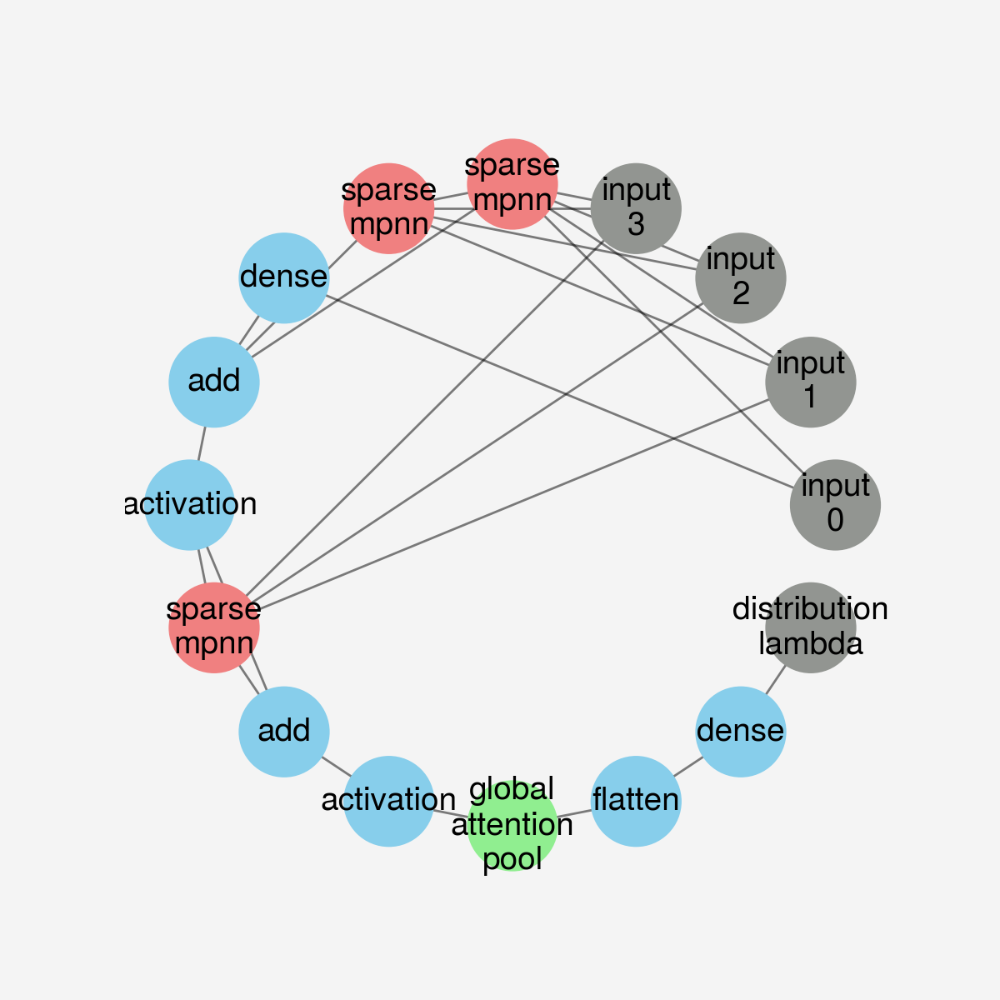

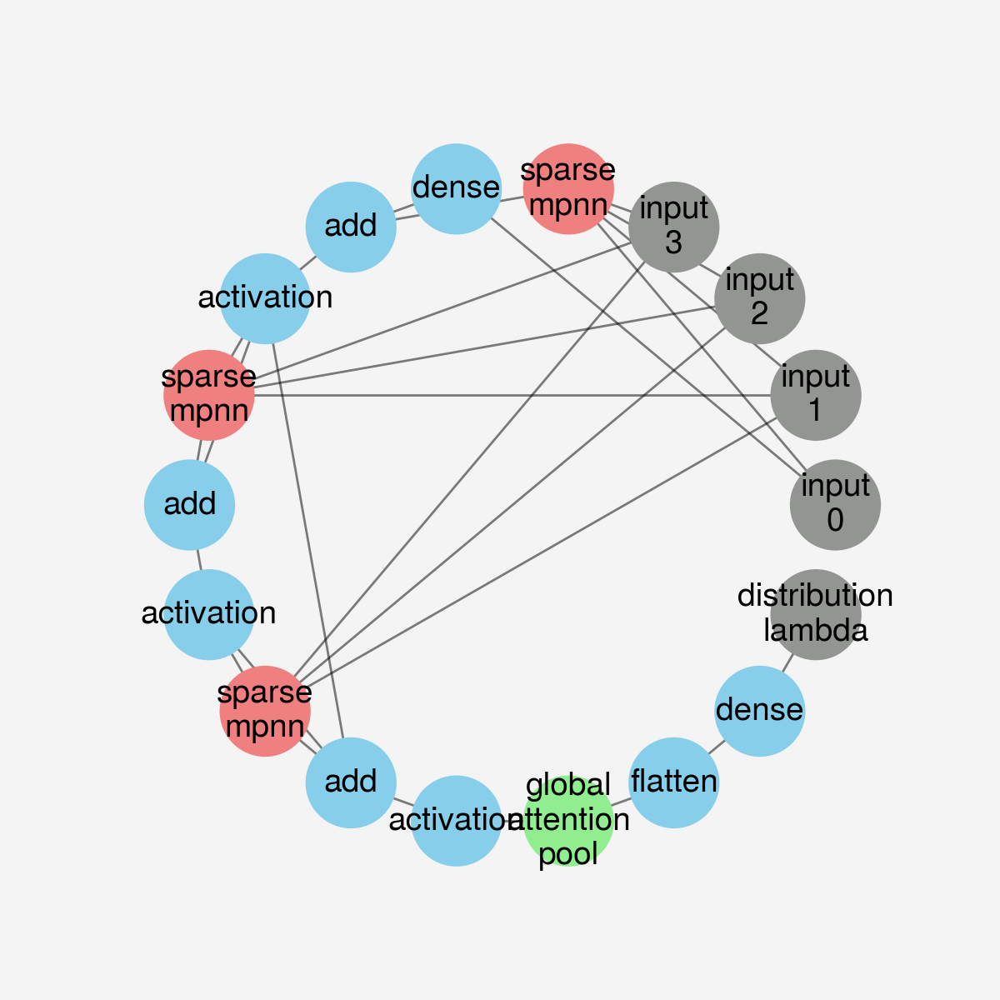

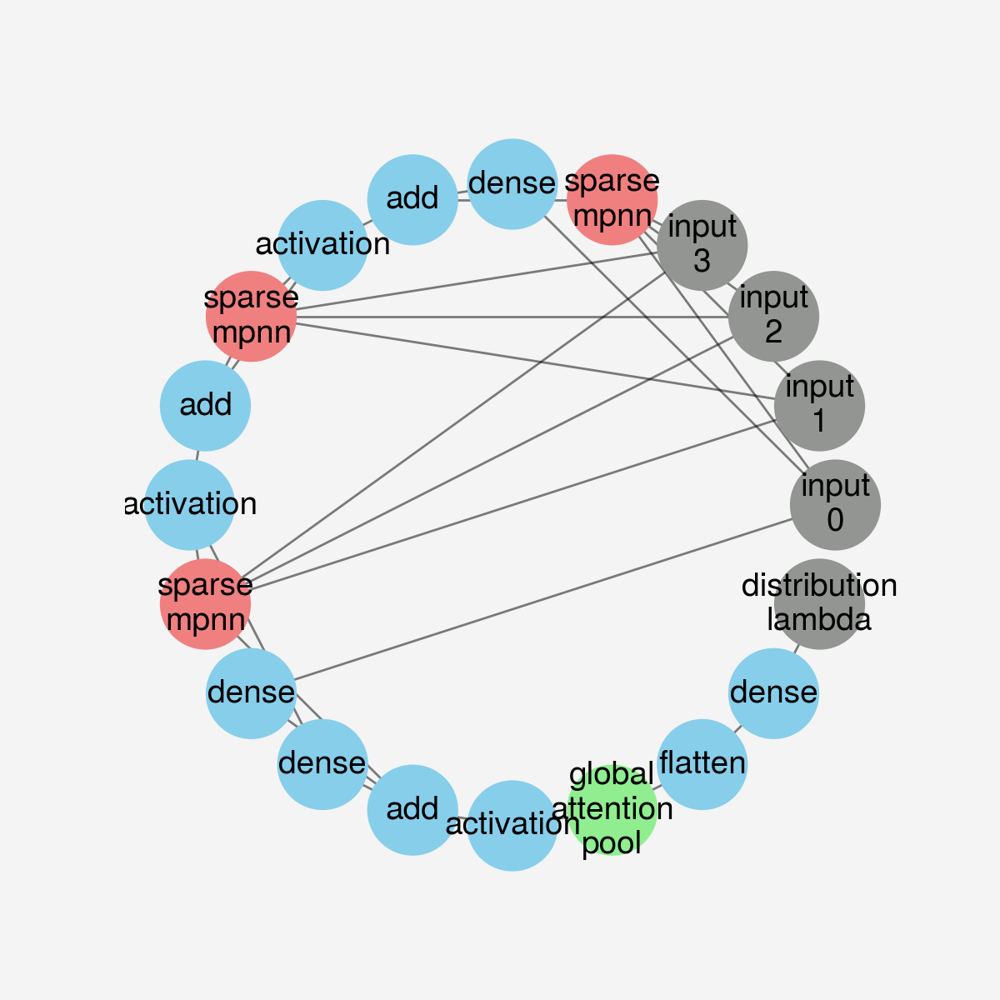

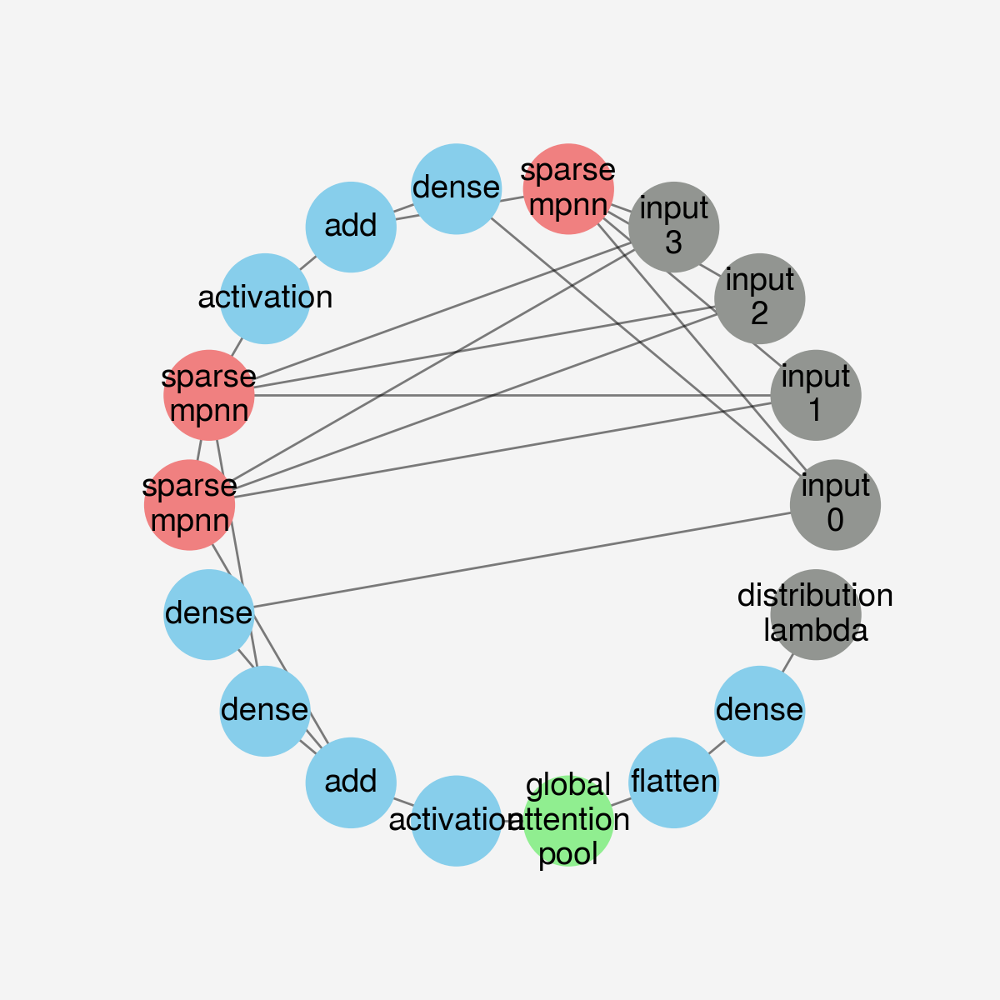

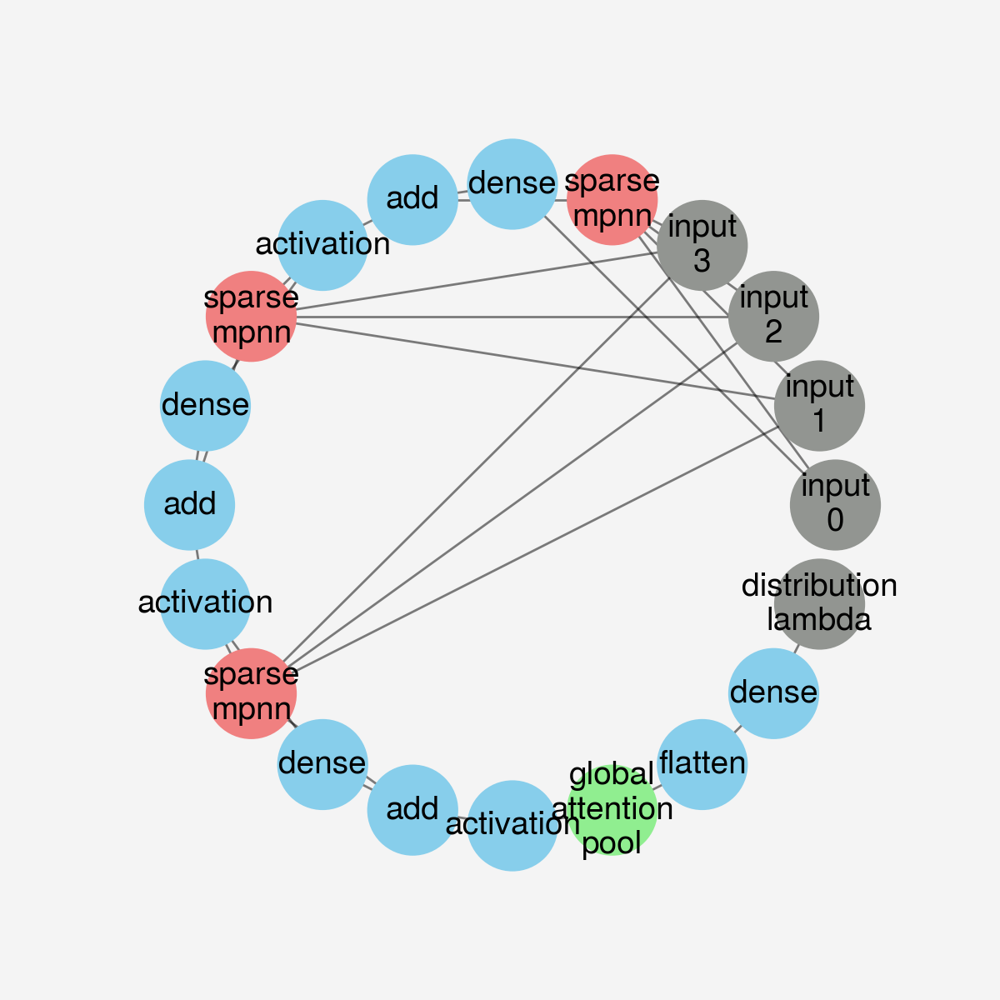

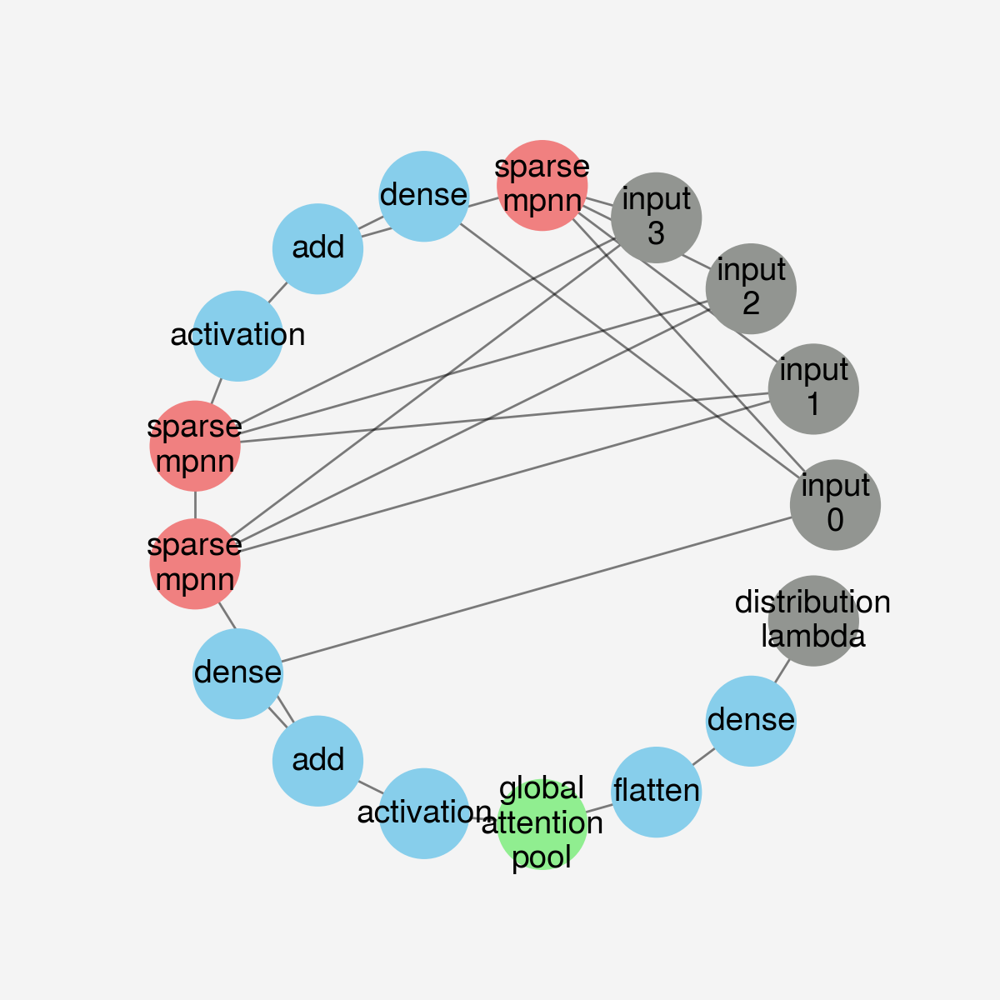

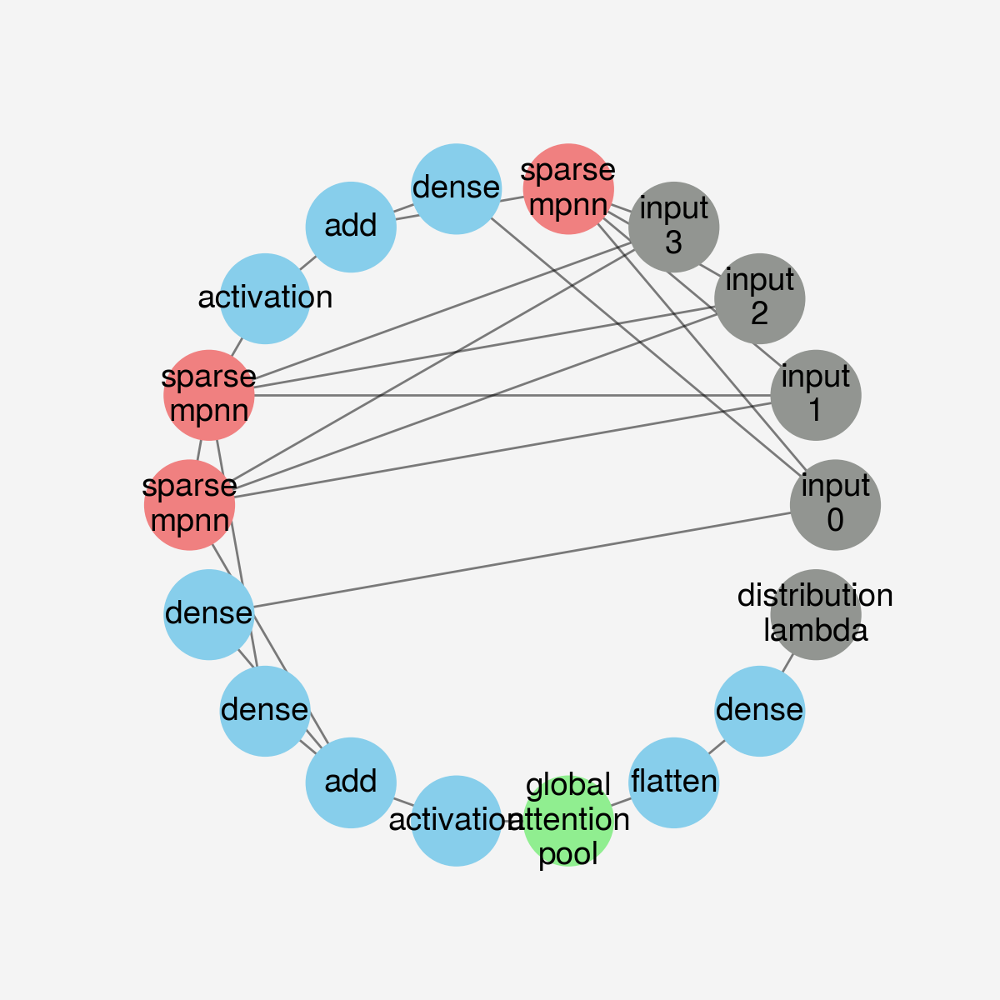

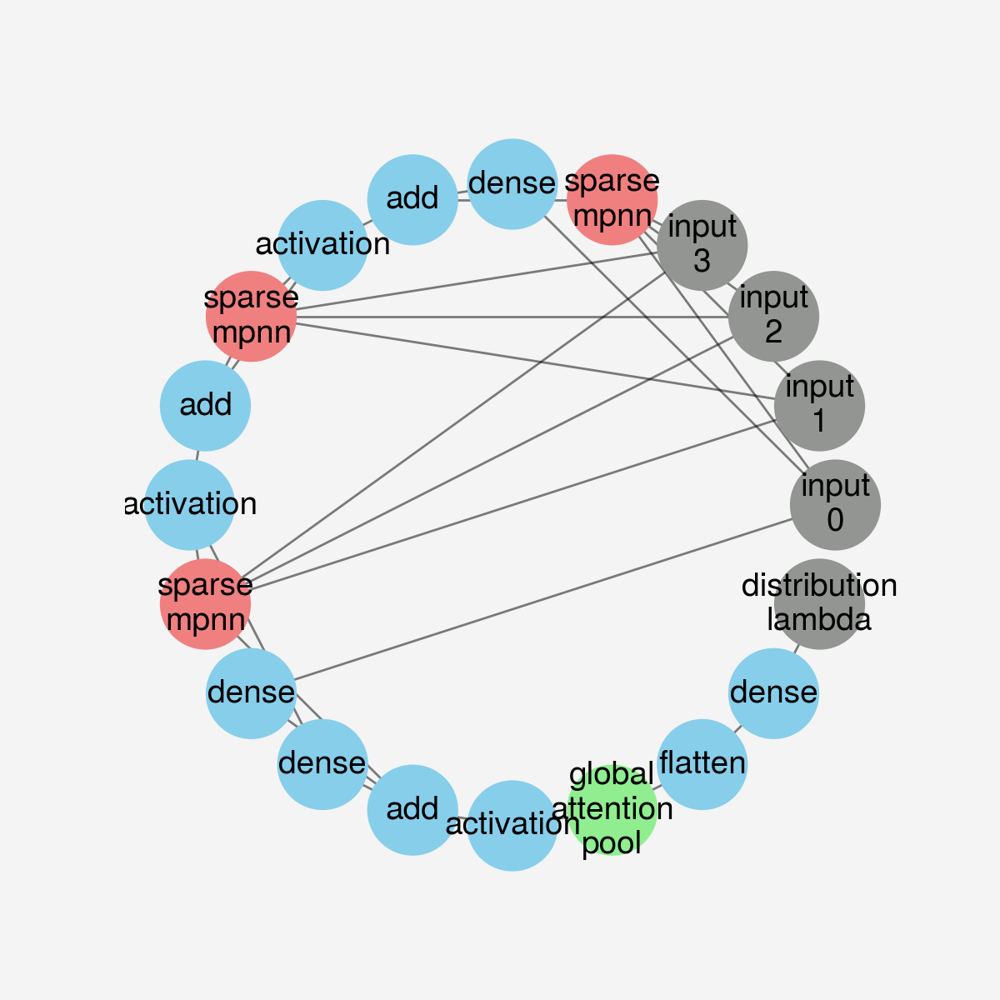

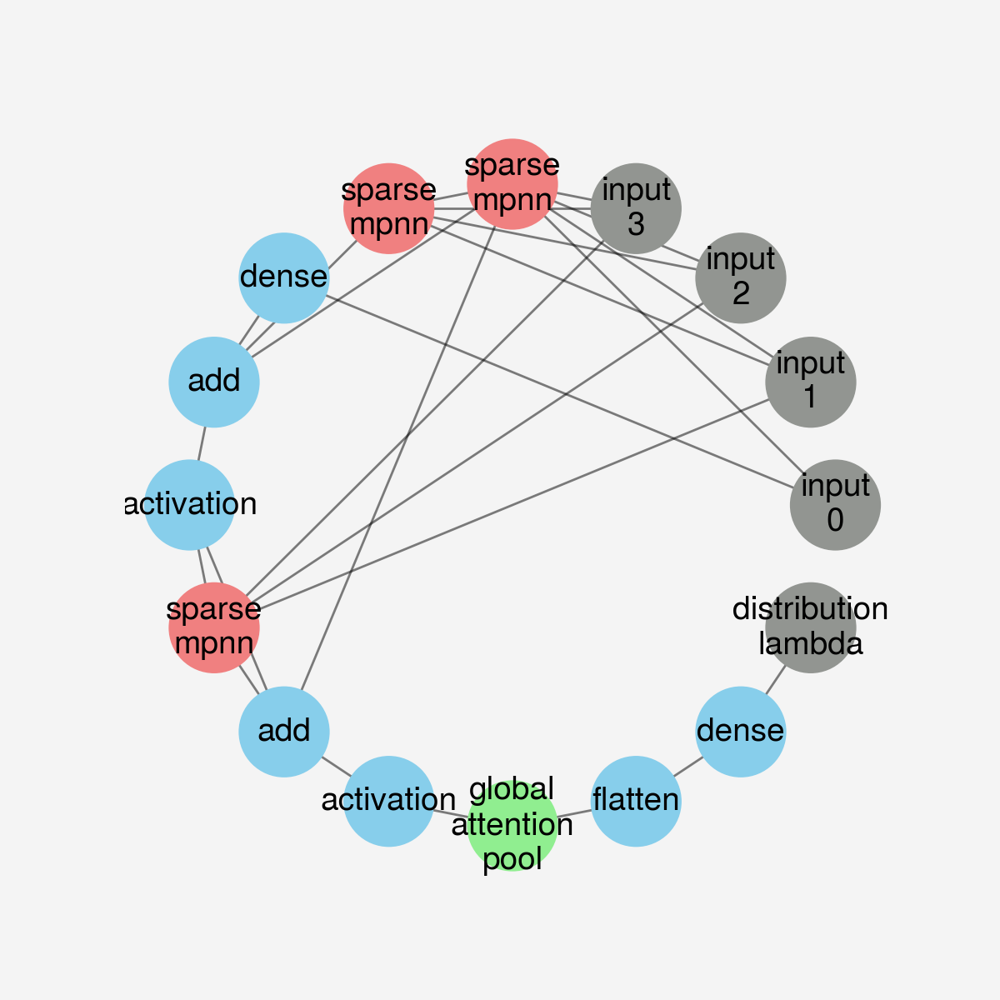

In [121]:
for best in range(10):
    df = pd.read_csv('../result/NEW_RE_lipo_random_0/results.csv')

    arch = df['arch_seq'][np.argsort(df['objective']).values[-best-1]]
    arch = ast.literal_eval(arch)

    input_shape = [(56, 133), (235, 2), (235, 14), (56,)]
    output_shape = (1,)

    shapes = dict(input_shape=input_shape, output_shape=output_shape)

    space = RegressionUQSpace(**shapes).build()

    model = space.sample(choice=arch)

    G = nx.DiGraph()

    for i, layer in enumerate(model.layers):
        G.add_node(layer.name, layer_type=layer.__class__.__name__)

    for layer in model.layers:
        for node in layer._inbound_nodes:
            inbound_layers = node.inbound_layers
            if not isinstance(inbound_layers, list):
                inbound_layers = [inbound_layers]
            for inbound_layer in inbound_layers:
                G.add_edge(inbound_layer.name, layer.name)


    plt.figure(figsize=(6, 6))

    pos = nx.circular_layout(G)

    def draw_edges(G, pos, width=1.0, alpha=0.5):
        for edge in G.edges():
            x0, y0 = pos[edge[0]]
            x1, y1 = pos[edge[1]]
            plt.plot([x0, x1], [y0, y1], 'k-', lw=width, alpha=alpha, zorder=1)

    draw_edges(G, pos, width=1.0, alpha=0.5)

    def node_name(node):
        node = node.split('_')
        if node[0] == 'sparse' or node[0] == 'input' or node[0] == 'distribution':
            node = '\n'.join(node[:2])
        elif node[0] in ['add', 'dense', 'flatten', 'activation']:
            node = node[0]
        elif len(node) > 1 and len(node) < 4:
            node = '\n'.join(node)
        elif len(node) >= 4:
            node = '\n'.join(node[:len(node)-1])
        else:
            node = node[0]

        if node == 'input 0':
            node = 'node\nfeature'
        elif node == 'input 1':
            node = 'edge\nfeature'
        elif node == 'input 2':
            node = 'edge\npair'
        elif node == 'input 3':
            node = 'node\nmask'
        elif node == 'distribution lambda':
            node = 'output\ndistribution'

        return node


    def node_color(node):
        node = node.split('_')
        if node[0] == 'input' or node[0] == 'distribution':
            color = 'grey'
        elif node[0] == 'sparse':
            color = 'lightcoral'
        elif node[0] in ['add', 'dense', 'flatten', 'activation']:
            color = 'skyblue'
        else:
            color = 'lightgreen'
        return color

    node_colors = [node_color(node) for node in G.nodes()]
    nx.draw_networkx_nodes(G, pos, node_size=1500, zorder=2, node_color=node_colors)
    labels = {node: node_name(node) for node in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels, font_size=14)
    
    plt.axis('off')
    plt.xlim([-1.2, 1.2])
    plt.ylim([-1.2, 1.2])
    
    plt.savefig(f'../fig/lipo_model_{best}.png', dpi=300, bbox_inches='tight')
    plt.show()

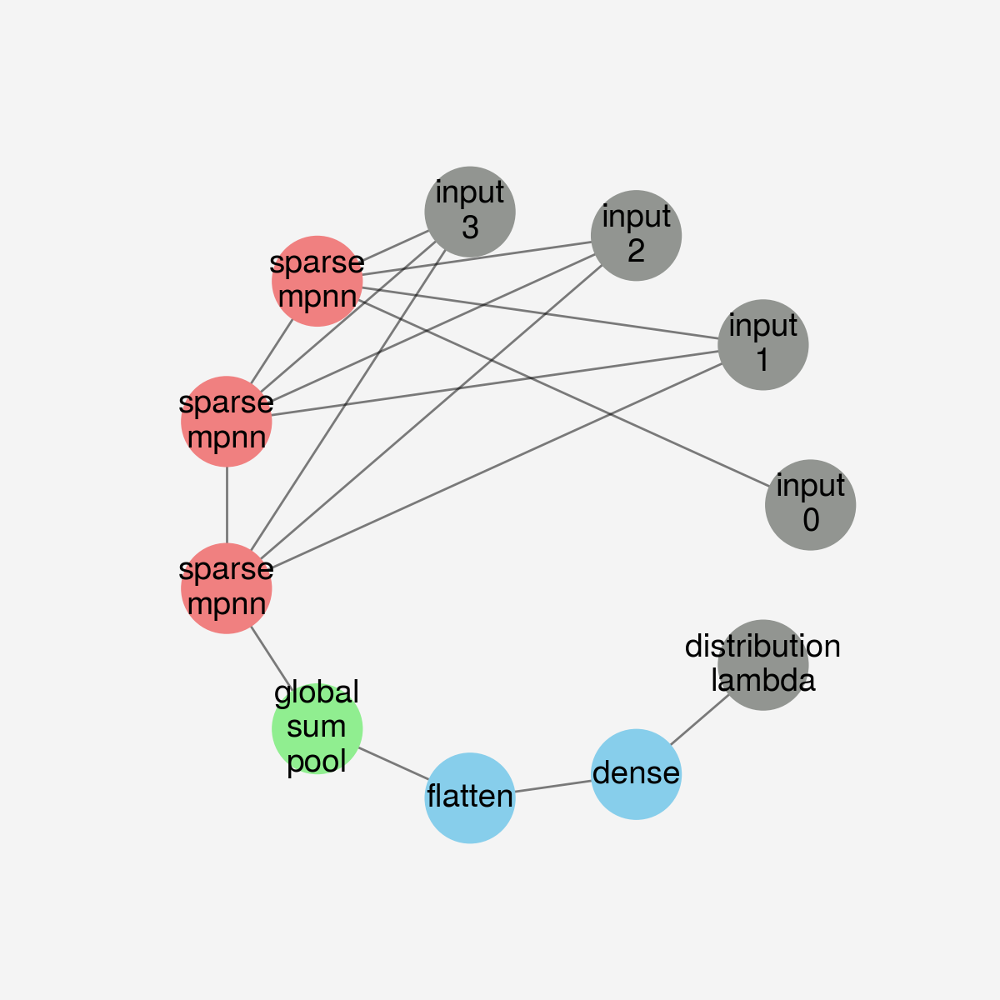

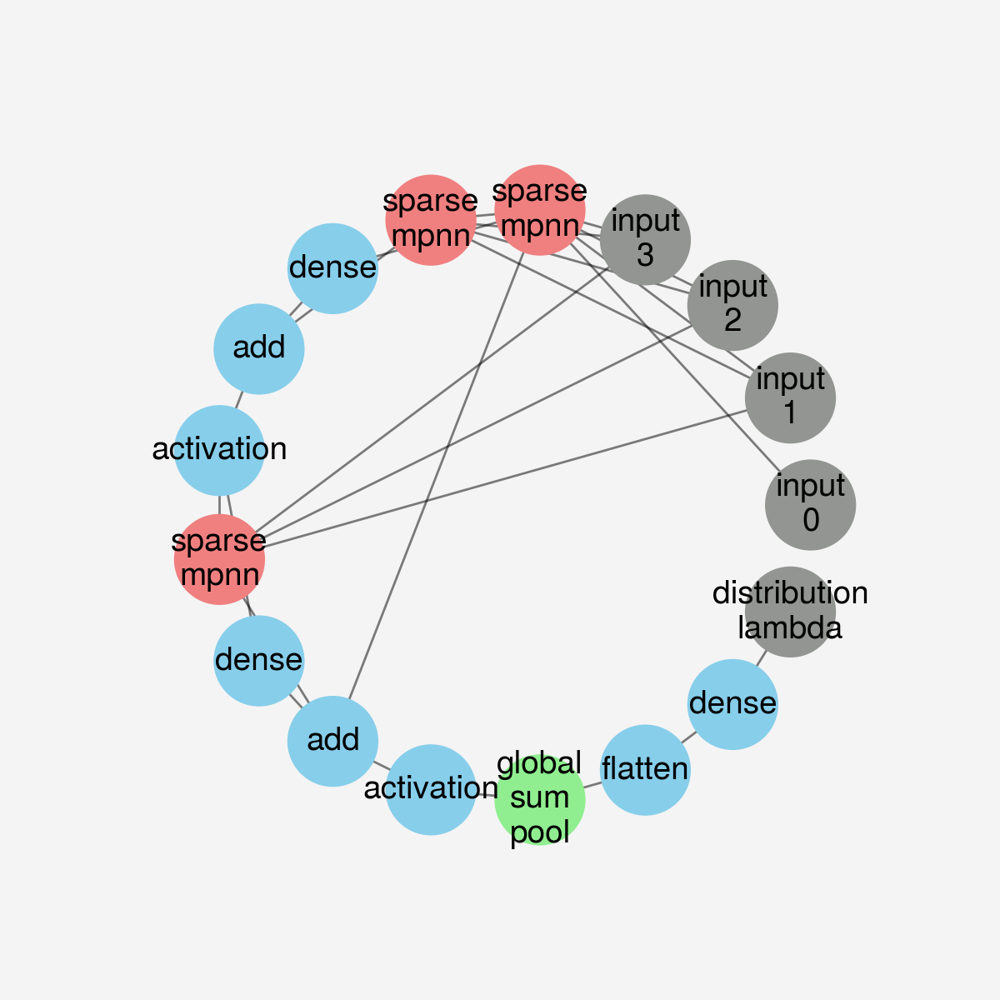

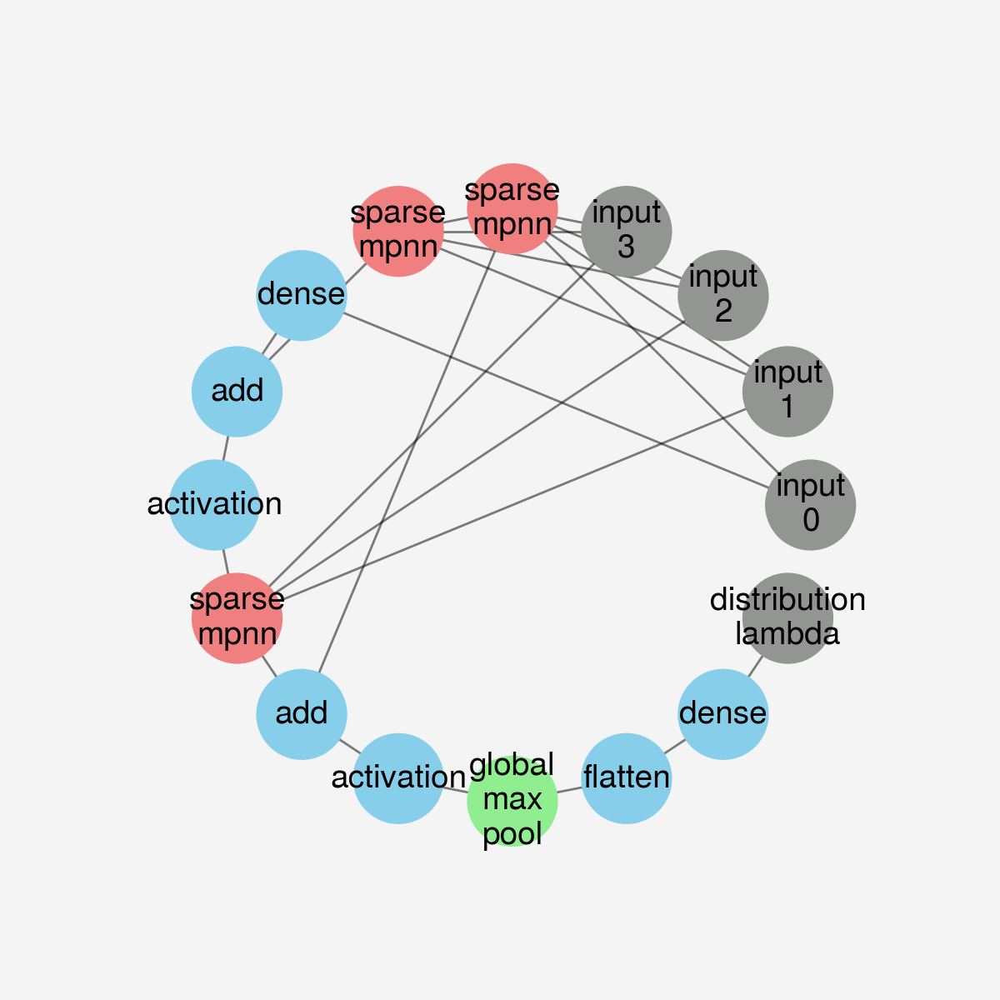

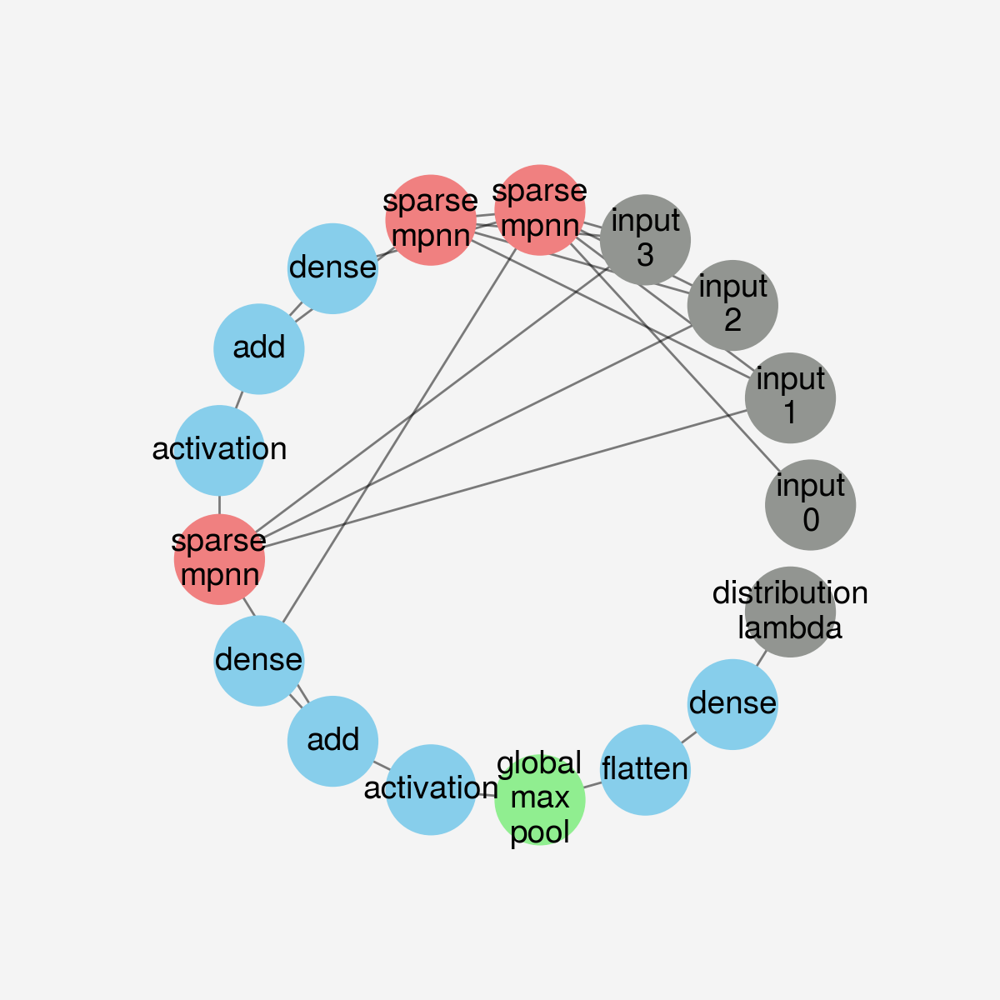

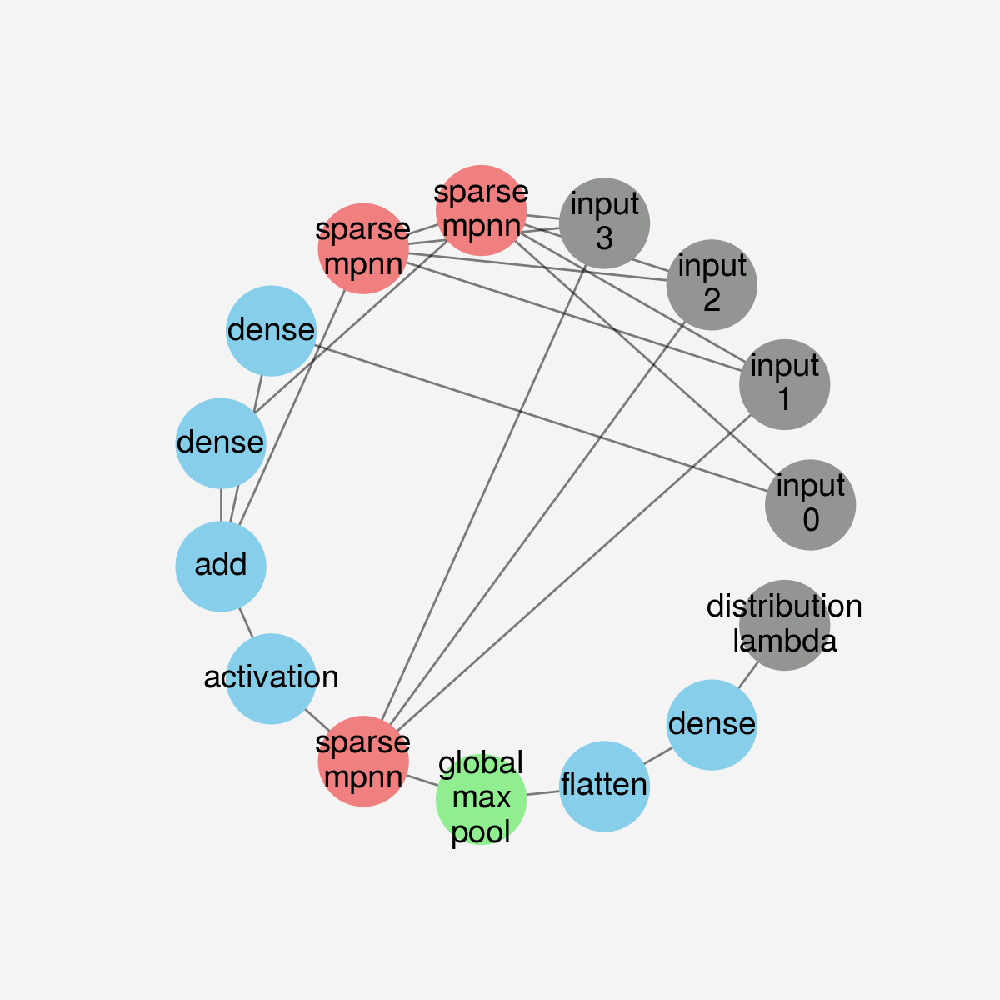

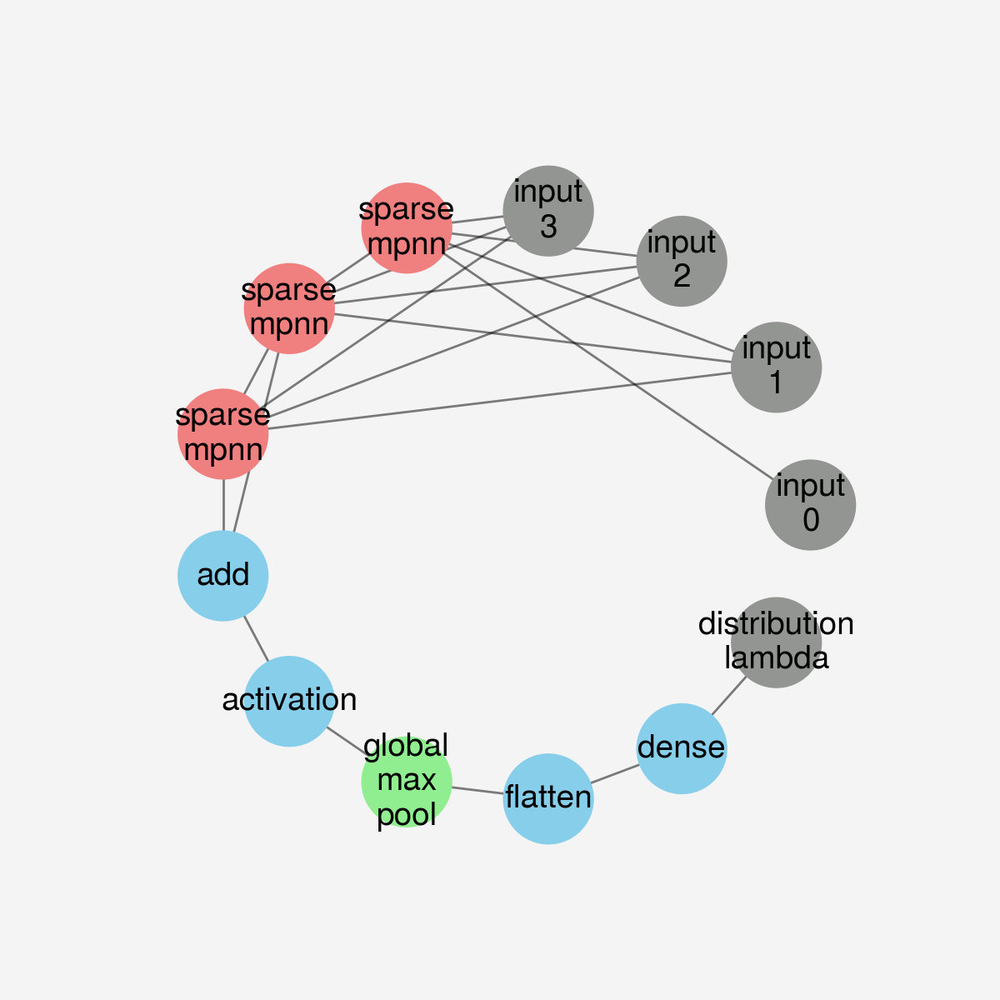

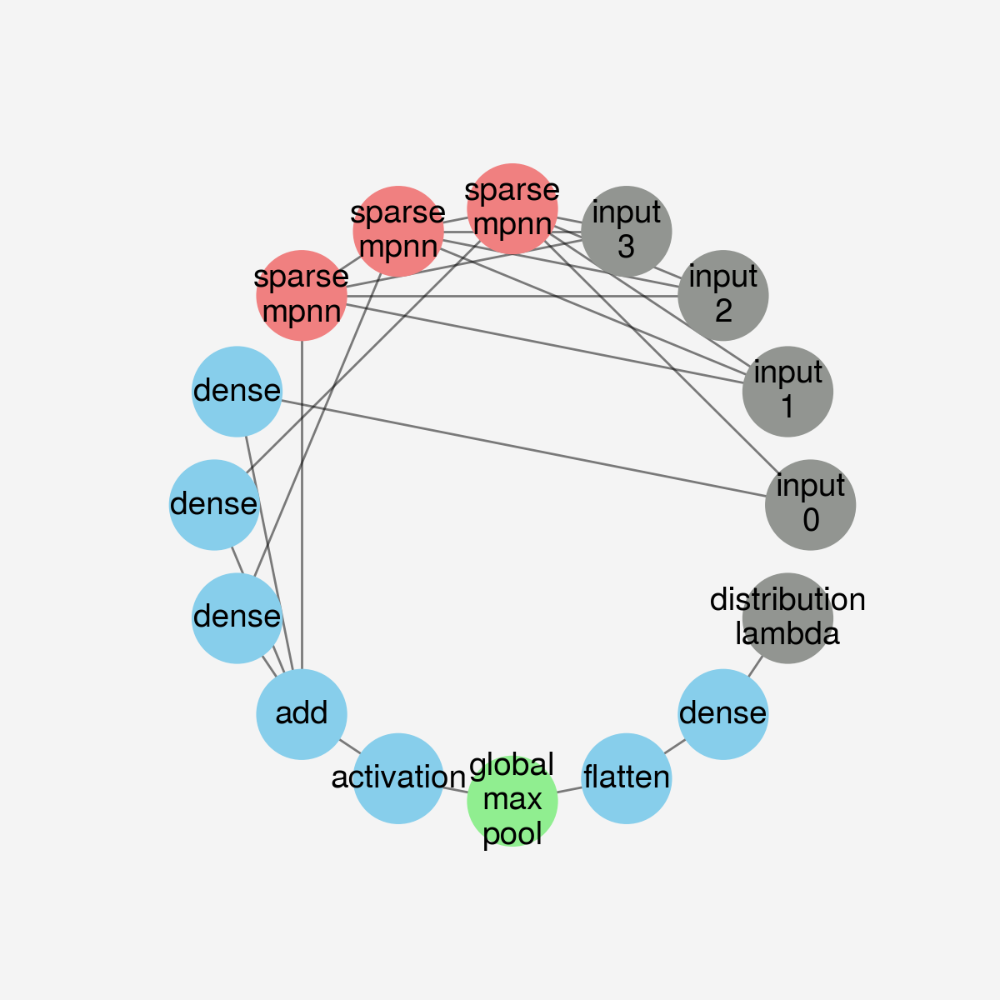

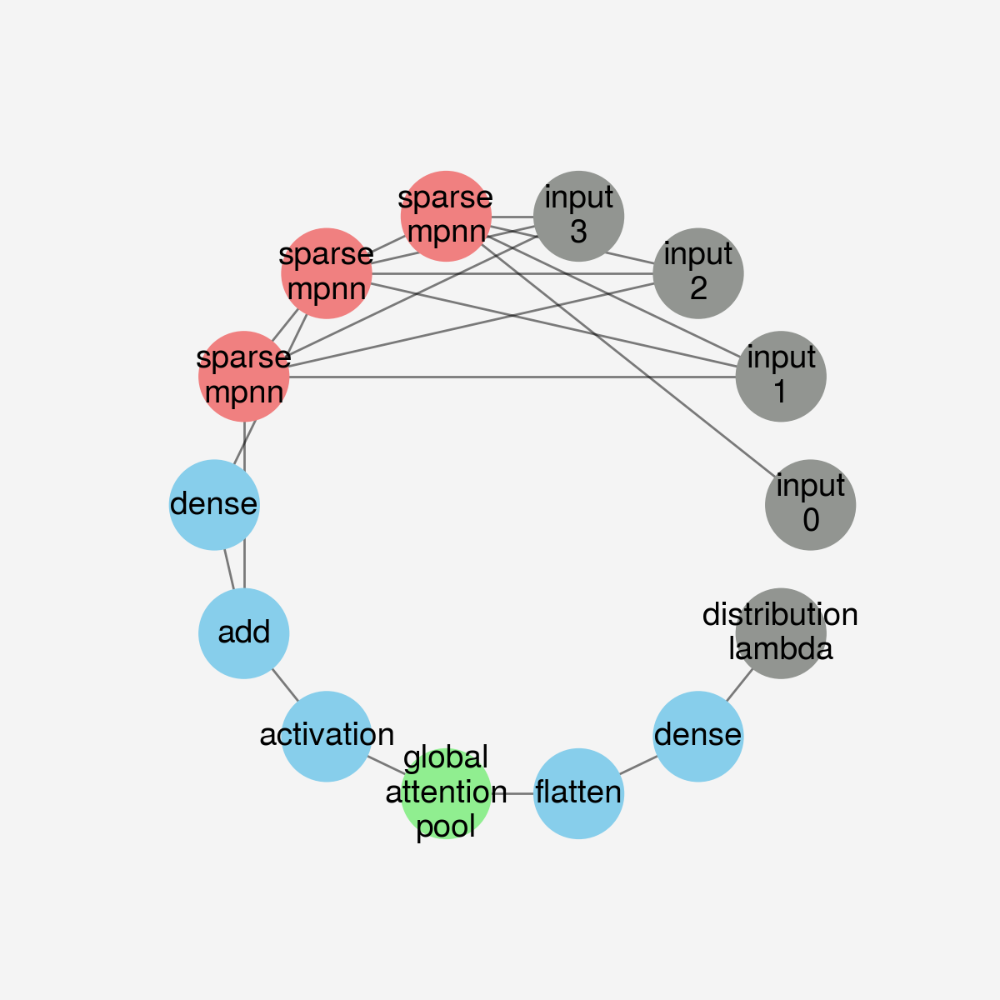

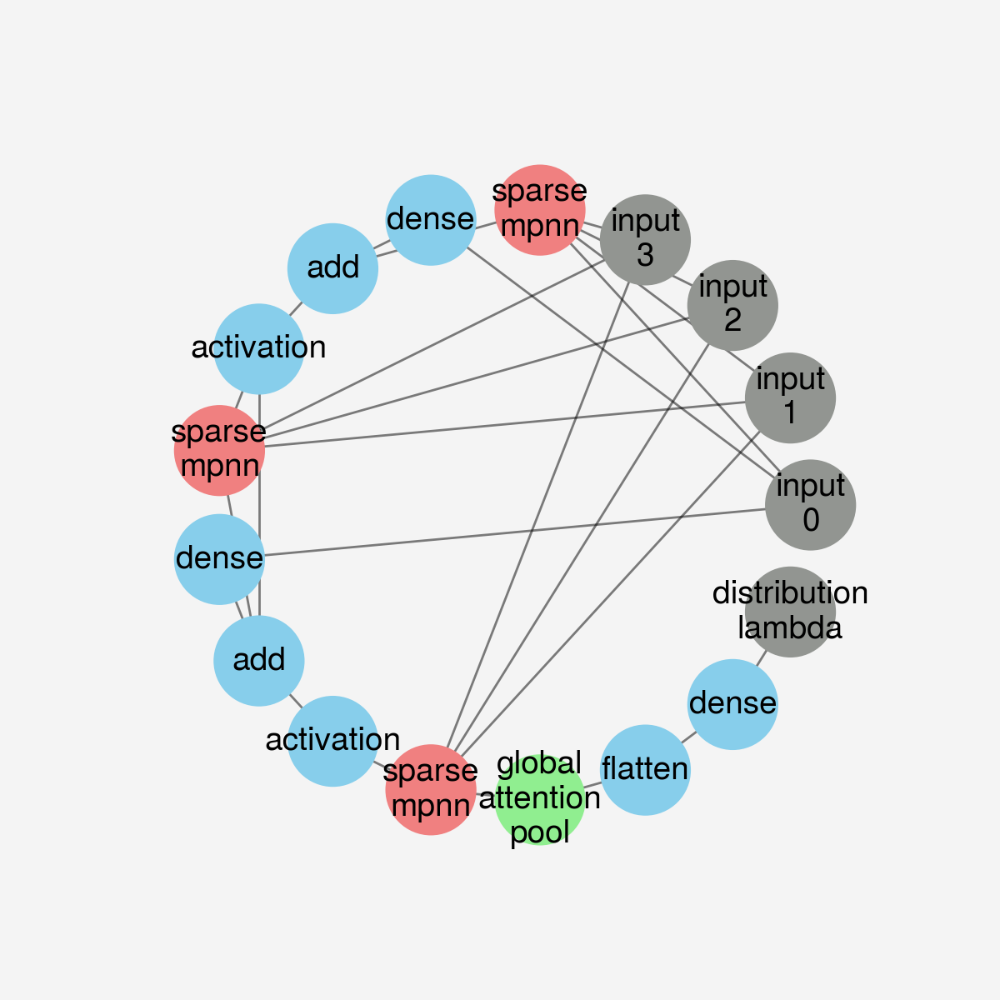

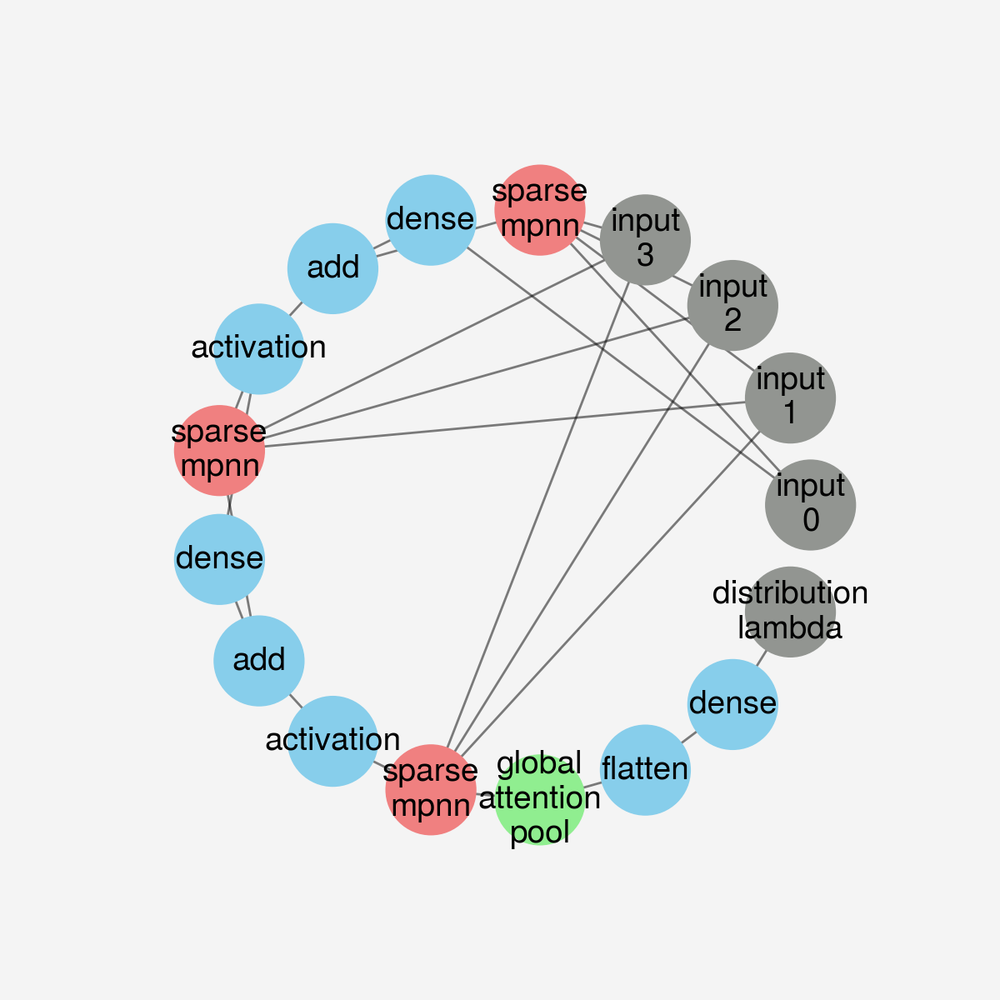

In [122]:
for worst in range(10):
    df = pd.read_csv('../result/NEW_RE_lipo_random_0/results.csv')

    arch = df['arch_seq'][np.argsort(df['objective']).values[worst]]
    arch = ast.literal_eval(arch)

    input_shape = [(56, 133), (235, 2), (235, 14), (56,)]
    output_shape = (1,)

    shapes = dict(input_shape=input_shape, output_shape=output_shape)

    space = RegressionUQSpace(**shapes).build()

    model = space.sample(choice=arch)

    G = nx.DiGraph()

    for i, layer in enumerate(model.layers):
        G.add_node(layer.name, layer_type=layer.__class__.__name__)

    for layer in model.layers:
        for node in layer._inbound_nodes:
            inbound_layers = node.inbound_layers
            if not isinstance(inbound_layers, list):
                inbound_layers = [inbound_layers]
            for inbound_layer in inbound_layers:
                G.add_edge(inbound_layer.name, layer.name)


    plt.figure(figsize=(6, 6))

    pos = nx.circular_layout(G)

    def draw_edges(G, pos, width=1.0, alpha=0.5):
        for edge in G.edges():
            x0, y0 = pos[edge[0]]
            x1, y1 = pos[edge[1]]
            plt.plot([x0, x1], [y0, y1], 'k-', lw=width, alpha=alpha, zorder=1)

    draw_edges(G, pos, width=1.0, alpha=0.5)

    def node_name(node):
        node = node.split('_')
        if node[0] == 'sparse' or node[0] == 'input' or node[0] == 'distribution':
            node = '\n'.join(node[:2])
        elif node[0] in ['add', 'dense', 'flatten', 'activation']:
            node = node[0]
        elif len(node) > 1 and len(node) < 4:
            node = '\n'.join(node)
        elif len(node) >= 4:
            node = '\n'.join(node[:len(node)-1])
        else:
            node = node[0]

        if node == 'input 0':
            node = 'node\nfeature'
        elif node == 'input 1':
            node = 'edge\nfeature'
        elif node == 'input 2':
            node = 'edge\npair'
        elif node == 'input 3':
            node = 'node\nmask'
        elif node == 'distribution lambda':
            node = 'output\ndistribution'

        return node


    def node_color(node):
        node = node.split('_')
        if node[0] == 'input' or node[0] == 'distribution':
            color = 'grey'
        elif node[0] == 'sparse':
            color = 'lightcoral'
        elif node[0] in ['add', 'dense', 'flatten', 'activation']:
            color = 'skyblue'
        else:
            color = 'lightgreen'
        return color

    node_colors = [node_color(node) for node in G.nodes()]
    nx.draw_networkx_nodes(G, pos, node_size=1500, zorder=2, node_color=node_colors)

    labels = {node: node_name(node) for node in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels, font_size=14)
    
    plt.axis('off')
    plt.xlim([-1.3, 1.3])
    plt.ylim([-1.3, 1.3])
    plt.savefig(f'../fig/lipo_model_worst_{worst}.png', dpi=300, bbox_inches='tight')
    plt.show()